# Afriat

In [1]:
scan=0.1383

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2546,3291,9406
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2546,2602,1687,3415,1648,3345
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4450,10793
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 659,818,2333
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 659,600,421,875,401,854
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1134,2676
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:27:01, 14.73s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:27:01, 14.73s/it, v_num=1, total_loss_train=3.69e+3, kl_local_train=49.6]

Epoch 2/600:   0%|          | 1/600 [00:14<2:27:01, 14.73s/it, v_num=1, total_loss_train=3.69e+3, kl_local_train=49.6]

Epoch 2/600:   0%|          | 2/600 [00:28<2:20:01, 14.05s/it, v_num=1, total_loss_train=3.69e+3, kl_local_train=49.6]

Epoch 2/600:   0%|          | 2/600 [00:28<2:20:01, 14.05s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=77]  

Epoch 3/600:   0%|          | 2/600 [00:28<2:20:01, 14.05s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=77]

Epoch 3/600:   0%|          | 3/600 [00:41<2:15:33, 13.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=77]

Epoch 3/600:   0%|          | 3/600 [00:41<2:15:33, 13.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.4]

Epoch 4/600:   0%|          | 3/600 [00:41<2:15:33, 13.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.4]

Epoch 4/600:   1%|          | 4/600 [00:54<2:12:47, 13.37s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.4]

Epoch 4/600:   1%|          | 4/600 [00:54<2:12:47, 13.37s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=76.9]

Epoch 5/600:   1%|          | 4/600 [00:54<2:12:47, 13.37s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=76.9]

Epoch 5/600:   1%|          | 5/600 [01:07<2:12:17, 13.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=76.9]

Epoch 5/600:   1%|          | 5/600 [01:07<2:12:17, 13.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=71.3]

Epoch 6/600:   1%|          | 5/600 [01:09<2:12:17, 13.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=71.3]

Epoch 6/600:   1%|          | 6/600 [01:21<2:14:12, 13.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=71.3]

Epoch 6/600:   1%|          | 6/600 [01:21<2:14:12, 13.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:21<2:14:12, 13.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:34<2:10:43, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:34<2:10:43, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:34<2:10:43, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:47<2:09:18, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:47<2:09:18, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:47<2:09:18, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:59<2:07:07, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:59<2:07:07, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:59<2:07:07, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:12<2:05:56, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:12<2:05:56, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=30, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]  

Epoch 11/600:   2%|▏         | 10/600 [02:13<2:05:56, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=30, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:26<2:09:22, 13.18s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=30, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:26<2:09:22, 13.18s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=39.4, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 12/600:   2%|▏         | 11/600 [02:26<2:09:22, 13.18s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=39.4, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 12/600:   2%|▏         | 12/600 [02:38<2:07:53, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=39.4, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 12/600:   2%|▏         | 12/600 [02:38<2:07:53, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=45.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 13/600:   2%|▏         | 12/600 [02:38<2:07:53, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=45.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 13/600:   2%|▏         | 13/600 [02:51<2:06:20, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=45.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 13/600:   2%|▏         | 13/600 [02:51<2:06:20, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=52.7, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 14/600:   2%|▏         | 13/600 [02:51<2:06:20, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=52.7, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 14/600:   2%|▏         | 14/600 [03:03<2:04:54, 12.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=52.7, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 14/600:   2%|▏         | 14/600 [03:03<2:04:54, 12.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=57.7, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 15/600:   2%|▏         | 14/600 [03:04<2:04:54, 12.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=57.7, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 15/600:   2%|▎         | 15/600 [03:16<2:04:15, 12.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=57.7, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 15/600:   2%|▎         | 15/600 [03:16<2:04:15, 12.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=59.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 16/600:   2%|▎         | 15/600 [03:17<2:04:15, 12.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=59.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 16/600:   3%|▎         | 16/600 [03:30<2:07:25, 13.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=59.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.0198, metric_mi|mouse_train=0.0455]

Epoch 16/600:   3%|▎         | 16/600 [03:30<2:07:25, 13.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 17/600:   3%|▎         | 16/600 [03:30<2:07:25, 13.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 17/600:   3%|▎         | 17/600 [03:43<2:06:17, 13.00s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 17/600:   3%|▎         | 17/600 [03:43<2:06:17, 13.00s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 18/600:   3%|▎         | 17/600 [03:43<2:06:17, 13.00s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 18/600:   3%|▎         | 18/600 [03:55<2:04:34, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 18/600:   3%|▎         | 18/600 [03:55<2:04:34, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 19/600:   3%|▎         | 18/600 [03:55<2:04:34, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 19/600:   3%|▎         | 19/600 [04:08<2:03:16, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 19/600:   3%|▎         | 19/600 [04:08<2:03:16, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 20/600:   3%|▎         | 19/600 [04:08<2:03:16, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 20/600:   3%|▎         | 20/600 [04:20<2:02:28, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 20/600:   3%|▎         | 20/600 [04:20<2:02:28, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 21/600:   3%|▎         | 20/600 [04:22<2:02:28, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 21/600:   4%|▎         | 21/600 [04:34<2:06:19, 13.09s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0679]

Epoch 21/600:   4%|▎         | 21/600 [04:34<2:06:19, 13.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=93.1, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]  

Epoch 22/600:   4%|▎         | 21/600 [04:34<2:06:19, 13.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=93.1, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 22/600:   4%|▎         | 22/600 [04:47<2:04:27, 12.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=93.1, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 22/600:   4%|▎         | 22/600 [04:47<2:04:27, 12.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875] 

Epoch 23/600:   4%|▎         | 22/600 [04:47<2:04:27, 12.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 23/600:   4%|▍         | 23/600 [04:59<2:03:02, 12.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 23/600:   4%|▍         | 23/600 [04:59<2:03:02, 12.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 24/600:   4%|▍         | 23/600 [04:59<2:03:02, 12.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 24/600:   4%|▍         | 24/600 [05:12<2:02:43, 12.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 24/600:   4%|▍         | 24/600 [05:12<2:02:43, 12.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 25/600:   4%|▍         | 24/600 [05:12<2:02:43, 12.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 25/600:   4%|▍         | 25/600 [05:25<2:01:50, 12.71s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 25/600:   4%|▍         | 25/600 [05:25<2:01:50, 12.71s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 26/600:   4%|▍         | 25/600 [05:26<2:01:50, 12.71s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 26/600:   4%|▍         | 26/600 [05:39<2:05:36, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0875]

Epoch 26/600:   4%|▍         | 26/600 [05:39<2:05:36, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 27/600:   4%|▍         | 26/600 [05:39<2:05:36, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 27/600:   4%|▍         | 27/600 [05:51<2:03:45, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 27/600:   4%|▍         | 27/600 [05:51<2:03:45, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 28/600:   4%|▍         | 27/600 [05:51<2:03:45, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 28/600:   5%|▍         | 28/600 [06:04<2:02:08, 12.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 28/600:   5%|▍         | 28/600 [06:04<2:02:08, 12.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 29/600:   5%|▍         | 28/600 [06:04<2:02:08, 12.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 29/600:   5%|▍         | 29/600 [06:16<2:01:07, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 29/600:   5%|▍         | 29/600 [06:16<2:01:07, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 30/600:   5%|▍         | 29/600 [06:16<2:01:07, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 30/600:   5%|▌         | 30/600 [06:29<2:00:28, 12.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 30/600:   5%|▌         | 30/600 [06:29<2:00:28, 12.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 31/600:   5%|▌         | 30/600 [06:30<2:00:28, 12.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 31/600:   5%|▌         | 31/600 [06:43<2:04:02, 13.08s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.107]

Epoch 31/600:   5%|▌         | 31/600 [06:43<2:04:02, 13.08s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]   

Epoch 32/600:   5%|▌         | 31/600 [06:43<2:04:02, 13.08s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 32/600:   5%|▌         | 32/600 [06:55<2:02:08, 12.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 32/600:   5%|▌         | 32/600 [06:55<2:02:08, 12.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 33/600:   5%|▌         | 32/600 [06:55<2:02:08, 12.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 33/600:   6%|▌         | 33/600 [07:08<2:01:07, 12.82s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 33/600:   6%|▌         | 33/600 [07:08<2:01:07, 12.82s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 33/600 [07:08<2:01:07, 12.82s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 34/600 [07:21<2:00:23, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 34/600 [07:21<2:00:23, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 34/600 [07:21<2:00:23, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 35/600 [07:34<2:02:06, 12.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 35/600 [07:34<2:02:06, 12.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 35/600 [07:35<2:02:06, 12.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 36/600 [07:49<2:06:53, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 36/600 [07:49<2:06:53, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118] 

Epoch 37/600:   6%|▌         | 36/600 [07:49<2:06:53, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [08:02<2:04:59, 13.32s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [08:02<2:04:59, 13.32s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▌         | 37/600 [08:02<2:04:59, 13.32s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:15<2:03:21, 13.17s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:15<2:03:21, 13.17s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 38/600 [08:15<2:03:21, 13.17s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:28<2:03:44, 13.23s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:28<2:03:44, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118] 

Epoch 40/600:   6%|▋         | 39/600 [08:28<2:03:44, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:41<2:03:46, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:41<2:03:46, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 40/600 [08:43<2:03:46, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [08:56<2:07:13, 13.65s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [08:56<2:07:13, 13.65s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 42/600:   7%|▋         | 41/600 [08:56<2:07:13, 13.65s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 42/600:   7%|▋         | 42/600 [09:09<2:06:05, 13.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 42/600:   7%|▋         | 42/600 [09:09<2:06:05, 13.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 43/600:   7%|▋         | 42/600 [09:09<2:06:05, 13.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 43/600:   7%|▋         | 43/600 [09:23<2:06:13, 13.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 43/600:   7%|▋         | 43/600 [09:23<2:06:13, 13.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 44/600:   7%|▋         | 43/600 [09:23<2:06:13, 13.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 44/600:   7%|▋         | 44/600 [09:37<2:06:21, 13.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 44/600:   7%|▋         | 44/600 [09:37<2:06:21, 13.64s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]  

Epoch 45/600:   7%|▋         | 44/600 [09:37<2:06:21, 13.64s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 45/600:   8%|▊         | 45/600 [09:50<2:06:28, 13.67s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 45/600:   8%|▊         | 45/600 [09:50<2:06:28, 13.67s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121] 

Epoch 46/600:   8%|▊         | 45/600 [09:52<2:06:28, 13.67s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 46/600:   8%|▊         | 46/600 [10:05<2:10:00, 14.08s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 46/600:   8%|▊         | 46/600 [10:05<2:10:00, 14.08s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 47/600:   8%|▊         | 46/600 [10:05<2:10:00, 14.08s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 47/600:   8%|▊         | 47/600 [10:19<2:08:45, 13.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 47/600:   8%|▊         | 47/600 [10:19<2:08:45, 13.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 48/600:   8%|▊         | 47/600 [10:19<2:08:45, 13.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 48/600:   8%|▊         | 48/600 [10:33<2:08:20, 13.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 48/600:   8%|▊         | 48/600 [10:33<2:08:20, 13.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 49/600:   8%|▊         | 48/600 [10:33<2:08:20, 13.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 49/600:   8%|▊         | 49/600 [10:47<2:07:31, 13.89s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 49/600:   8%|▊         | 49/600 [10:47<2:07:31, 13.89s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 50/600:   8%|▊         | 49/600 [10:47<2:07:31, 13.89s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 50/600:   8%|▊         | 50/600 [11:00<2:06:48, 13.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 50/600:   8%|▊         | 50/600 [11:00<2:06:48, 13.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 51/600:   8%|▊         | 50/600 [11:02<2:06:48, 13.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 51/600:   8%|▊         | 51/600 [11:15<2:09:37, 14.17s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 51/600:   8%|▊         | 51/600 [11:15<2:09:37, 14.17s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 52/600:   8%|▊         | 51/600 [11:15<2:09:37, 14.17s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|▊         | 52/600 [11:29<2:07:58, 14.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|▊         | 52/600 [11:29<2:07:58, 14.01s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127] 

Epoch 53/600:   9%|▊         | 52/600 [11:29<2:07:58, 14.01s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|▉         | 53/600 [11:43<2:06:56, 13.92s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|▉         | 53/600 [11:43<2:06:56, 13.92s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|▉         | 53/600 [11:43<2:06:56, 13.92s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|▉         | 54/600 [11:56<2:05:13, 13.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|▉         | 54/600 [11:56<2:05:13, 13.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|▉         | 54/600 [11:56<2:05:13, 13.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|▉         | 55/600 [12:10<2:04:44, 13.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|▉         | 55/600 [12:10<2:04:44, 13.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|▉         | 55/600 [12:11<2:04:44, 13.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|▉         | 56/600 [12:25<2:07:53, 14.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|▉         | 56/600 [12:25<2:07:53, 14.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 57/600:   9%|▉         | 56/600 [12:25<2:07:53, 14.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 57/600:  10%|▉         | 57/600 [12:38<2:06:23, 13.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 57/600:  10%|▉         | 57/600 [12:38<2:06:23, 13.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 58/600:  10%|▉         | 57/600 [12:38<2:06:23, 13.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 58/600:  10%|▉         | 58/600 [12:52<2:05:21, 13.88s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 58/600:  10%|▉         | 58/600 [12:52<2:05:21, 13.88s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 59/600:  10%|▉         | 58/600 [12:52<2:05:21, 13.88s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 59/600:  10%|▉         | 59/600 [13:06<2:04:34, 13.82s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 59/600:  10%|▉         | 59/600 [13:06<2:04:34, 13.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 60/600:  10%|▉         | 59/600 [13:06<2:04:34, 13.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 60/600:  10%|█         | 60/600 [13:19<2:03:40, 13.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 60/600:  10%|█         | 60/600 [13:19<2:03:40, 13.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 61/600:  10%|█         | 60/600 [13:21<2:03:40, 13.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 61/600:  10%|█         | 61/600 [13:34<2:07:09, 14.16s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 61/600:  10%|█         | 61/600 [13:34<2:07:09, 14.16s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 62/600:  10%|█         | 61/600 [13:34<2:07:09, 14.16s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 62/600:  10%|█         | 62/600 [13:48<2:05:34, 14.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 62/600:  10%|█         | 62/600 [13:48<2:05:34, 14.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 63/600:  10%|█         | 62/600 [13:48<2:05:34, 14.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 63/600:  10%|█         | 63/600 [14:02<2:03:39, 13.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 63/600:  10%|█         | 63/600 [14:02<2:03:39, 13.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 64/600:  10%|█         | 63/600 [14:02<2:03:39, 13.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 64/600:  11%|█         | 64/600 [14:15<2:03:02, 13.77s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 64/600:  11%|█         | 64/600 [14:15<2:03:02, 13.77s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 65/600:  11%|█         | 64/600 [14:15<2:03:02, 13.77s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 65/600:  11%|█         | 65/600 [14:29<2:02:24, 13.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 65/600:  11%|█         | 65/600 [14:29<2:02:24, 13.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 66/600:  11%|█         | 65/600 [14:30<2:02:24, 13.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 66/600:  11%|█         | 66/600 [14:44<2:05:16, 14.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 66/600:  11%|█         | 66/600 [14:44<2:05:16, 14.08s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|█         | 66/600 [14:44<2:05:16, 14.08s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|█         | 67/600 [14:57<2:03:46, 13.93s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|█         | 67/600 [14:57<2:03:46, 13.93s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|█         | 67/600 [14:57<2:03:46, 13.93s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|█▏        | 68/600 [15:11<2:02:53, 13.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|█▏        | 68/600 [15:11<2:02:53, 13.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 69/600:  11%|█▏        | 68/600 [15:11<2:02:53, 13.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 69/600:  12%|█▏        | 69/600 [15:25<2:02:43, 13.87s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 69/600:  12%|█▏        | 69/600 [15:25<2:02:43, 13.87s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|█▏        | 69/600 [15:25<2:02:43, 13.87s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|█▏        | 70/600 [15:38<2:01:51, 13.80s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|█▏        | 70/600 [15:38<2:01:51, 13.80s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|█▏        | 70/600 [15:40<2:01:51, 13.80s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|█▏        | 71/600 [15:53<2:04:48, 14.16s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|█▏        | 71/600 [15:53<2:04:48, 14.16s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12] 

Epoch 72/600:  12%|█▏        | 71/600 [15:54<2:04:48, 14.16s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 72/600 [16:07<2:02:24, 13.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 72/600 [16:07<2:02:24, 13.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 72/600 [16:07<2:02:24, 13.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 73/600 [16:21<2:01:46, 13.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 73/600 [16:21<2:01:46, 13.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 73/600 [16:21<2:01:46, 13.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 74/600 [16:34<2:00:55, 13.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 74/600 [16:34<2:00:55, 13.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]  

Epoch 75/600:  12%|█▏        | 74/600 [16:34<2:00:55, 13.79s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▎        | 75/600 [16:48<2:00:16, 13.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▎        | 75/600 [16:48<2:00:16, 13.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 76/600:  12%|█▎        | 75/600 [16:49<2:00:16, 13.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 76/600:  13%|█▎        | 76/600 [17:03<2:03:14, 14.11s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 76/600:  13%|█▎        | 76/600 [17:03<2:03:14, 14.11s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 76/600 [17:03<2:03:14, 14.11s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [17:17<2:01:56, 13.99s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [17:17<2:01:56, 13.99s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 77/600 [17:17<2:01:56, 13.99s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [17:30<2:01:01, 13.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [17:30<2:01:01, 13.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 78/600 [17:30<2:01:01, 13.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [17:44<2:00:14, 13.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [17:44<2:00:14, 13.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 79/600 [17:44<2:00:14, 13.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [17:58<1:59:26, 13.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [17:58<1:59:26, 13.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 81/600:  13%|█▎        | 80/600 [17:59<1:59:26, 13.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [18:13<2:02:20, 14.14s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [18:13<2:02:20, 14.14s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115] 

Epoch 82/600:  14%|█▎        | 81/600 [18:13<2:02:20, 14.14s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|█▎        | 82/600 [18:26<2:00:51, 14.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|█▎        | 82/600 [18:26<2:00:51, 14.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|█▎        | 82/600 [18:26<2:00:51, 14.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|█▍        | 83/600 [18:40<1:58:55, 13.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|█▍        | 83/600 [18:40<1:58:55, 13.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|█▍        | 83/600 [18:40<1:58:55, 13.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|█▍        | 84/600 [18:54<1:59:03, 13.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|█▍        | 84/600 [18:54<1:59:03, 13.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|█▍        | 84/600 [18:54<1:59:03, 13.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|█▍        | 85/600 [19:07<1:57:23, 13.68s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|█▍        | 85/600 [19:07<1:57:23, 13.68s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|█▍        | 85/600 [19:08<1:57:23, 13.68s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|█▍        | 86/600 [19:22<2:00:45, 14.10s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|█▍        | 86/600 [19:22<2:00:45, 14.10s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|█▍        | 86/600 [19:22<2:00:45, 14.10s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|█▍        | 87/600 [19:36<1:59:47, 14.01s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|█▍        | 87/600 [19:36<1:59:47, 14.01s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 88/600:  14%|█▍        | 87/600 [19:36<1:59:47, 14.01s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|█▍        | 88/600 [19:49<1:58:49, 13.92s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|█▍        | 88/600 [19:49<1:58:49, 13.92s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|█▍        | 88/600 [19:49<1:58:49, 13.92s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|█▍        | 89/600 [20:03<1:57:55, 13.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|█▍        | 89/600 [20:03<1:57:55, 13.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|█▍        | 89/600 [20:03<1:57:55, 13.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|█▌        | 90/600 [20:17<1:57:12, 13.79s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|█▌        | 90/600 [20:17<1:57:12, 13.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|█▌        | 90/600 [20:18<1:57:12, 13.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|█▌        | 91/600 [20:32<1:59:52, 14.13s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|█▌        | 91/600 [20:32<1:59:52, 14.13s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|█▌        | 91/600 [20:32<1:59:52, 14.13s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|█▌        | 92/600 [20:45<1:58:36, 14.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|█▌        | 92/600 [20:45<1:58:36, 14.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 93/600:  15%|█▌        | 92/600 [20:45<1:58:36, 14.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 93/600:  16%|█▌        | 93/600 [20:59<1:57:25, 13.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 93/600:  16%|█▌        | 93/600 [20:59<1:57:25, 13.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|█▌        | 93/600 [20:59<1:57:25, 13.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|█▌        | 94/600 [21:12<1:55:54, 13.74s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|█▌        | 94/600 [21:12<1:55:54, 13.74s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|█▌        | 94/600 [21:12<1:55:54, 13.74s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|█▌        | 95/600 [21:26<1:55:15, 13.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|█▌        | 95/600 [21:26<1:55:15, 13.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|█▌        | 95/600 [21:27<1:55:15, 13.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|█▌        | 96/600 [21:41<1:58:13, 14.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|█▌        | 96/600 [21:41<1:58:13, 14.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11] 

Epoch 97/600:  16%|█▌        | 96/600 [21:41<1:58:13, 14.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 97/600 [21:55<1:57:05, 13.97s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 97/600 [21:55<1:57:05, 13.97s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▌        | 97/600 [21:55<1:57:05, 13.97s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▋        | 98/600 [22:08<1:55:49, 13.84s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▋        | 98/600 [22:08<1:55:49, 13.84s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 98/600 [22:08<1:55:49, 13.84s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 99/600 [22:22<1:55:10, 13.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 99/600 [22:22<1:55:10, 13.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 100/600:  16%|█▋        | 99/600 [22:22<1:55:10, 13.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 100/600:  17%|█▋        | 100/600 [22:35<1:52:32, 13.50s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 100/600:  17%|█▋        | 100/600 [22:35<1:52:32, 13.50s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 100/600 [22:36<1:52:32, 13.50s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 101/600 [22:48<1:51:56, 13.46s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 101/600 [22:48<1:51:56, 13.46s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 102/600:  17%|█▋        | 101/600 [22:48<1:51:56, 13.46s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 102/600:  17%|█▋        | 102/600 [23:00<1:48:11, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 102/600:  17%|█▋        | 102/600 [23:00<1:48:11, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 103/600:  17%|█▋        | 102/600 [23:00<1:48:11, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 103/600:  17%|█▋        | 103/600 [23:12<1:45:36, 12.75s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 103/600:  17%|█▋        | 103/600 [23:12<1:45:36, 12.75s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 104/600:  17%|█▋        | 103/600 [23:12<1:45:36, 12.75s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 104/600:  17%|█▋        | 104/600 [23:24<1:43:44, 12.55s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 104/600:  17%|█▋        | 104/600 [23:24<1:43:44, 12.55s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 105/600:  17%|█▋        | 104/600 [23:24<1:43:44, 12.55s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 105/600:  18%|█▊        | 105/600 [23:37<1:44:11, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 105/600:  18%|█▊        | 105/600 [23:37<1:44:11, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 106/600:  18%|█▊        | 105/600 [23:38<1:44:11, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 106/600:  18%|█▊        | 106/600 [23:51<1:47:40, 13.08s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 106/600:  18%|█▊        | 106/600 [23:51<1:47:40, 13.08s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 106/600 [23:51<1:47:40, 13.08s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [24:04<1:45:53, 12.89s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [24:04<1:45:53, 12.89s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 107/600 [24:04<1:45:53, 12.89s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [24:16<1:43:47, 12.66s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [24:16<1:43:47, 12.66s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 108/600 [24:16<1:43:47, 12.66s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [24:28<1:42:36, 12.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [24:28<1:42:36, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 109/600 [24:28<1:42:36, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [24:40<1:41:46, 12.46s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [24:40<1:41:46, 12.46s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 110/600 [24:42<1:41:46, 12.46s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [24:54<1:44:12, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [24:54<1:44:12, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 112/600:  18%|█▊        | 111/600 [24:54<1:44:12, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 112/600:  19%|█▊        | 112/600 [25:06<1:42:49, 12.64s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 112/600:  19%|█▊        | 112/600 [25:06<1:42:49, 12.64s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▊        | 112/600 [25:06<1:42:49, 12.64s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▉        | 113/600 [25:18<1:41:46, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▉        | 113/600 [25:18<1:41:46, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 113/600 [25:18<1:41:46, 12.54s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 114/600 [25:31<1:41:02, 12.47s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 114/600 [25:31<1:41:02, 12.47s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 114/600 [25:31<1:41:02, 12.47s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 115/600 [25:43<1:40:23, 12.42s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 115/600 [25:43<1:40:23, 12.42s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 115/600 [25:44<1:40:23, 12.42s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 116/600 [25:57<1:42:57, 12.76s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 116/600 [25:57<1:42:57, 12.76s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 117/600:  19%|█▉        | 116/600 [25:57<1:42:57, 12.76s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [26:09<1:41:35, 12.62s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [26:09<1:41:35, 12.62s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 117/600 [26:09<1:41:35, 12.62s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [26:21<1:40:34, 12.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [26:21<1:40:34, 12.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 118/600 [26:21<1:40:34, 12.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [26:34<1:39:46, 12.45s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [26:34<1:39:46, 12.45s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|█▉        | 119/600 [26:34<1:39:46, 12.45s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [26:46<1:39:07, 12.39s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [26:46<1:39:07, 12.39s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 120/600 [26:47<1:39:07, 12.39s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [26:59<1:41:40, 12.74s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [26:59<1:41:40, 12.74s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103] 

Epoch 122/600:  20%|██        | 121/600 [26:59<1:41:40, 12.74s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 122/600:  20%|██        | 122/600 [27:12<1:40:27, 12.61s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 122/600:  20%|██        | 122/600 [27:12<1:40:27, 12.61s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 123/600:  20%|██        | 122/600 [27:12<1:40:27, 12.61s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 123/600:  20%|██        | 123/600 [27:24<1:39:27, 12.51s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 123/600:  20%|██        | 123/600 [27:24<1:39:27, 12.51s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 124/600:  20%|██        | 123/600 [27:24<1:39:27, 12.51s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 124/600:  21%|██        | 124/600 [27:36<1:38:45, 12.45s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 124/600:  21%|██        | 124/600 [27:36<1:38:45, 12.45s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 125/600:  21%|██        | 124/600 [27:36<1:38:45, 12.45s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 125/600:  21%|██        | 125/600 [27:49<1:38:23, 12.43s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 125/600:  21%|██        | 125/600 [27:49<1:38:23, 12.43s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 126/600:  21%|██        | 125/600 [27:50<1:38:23, 12.43s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 126/600:  21%|██        | 126/600 [28:02<1:40:52, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 126/600:  21%|██        | 126/600 [28:02<1:40:52, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103] 

Epoch 127/600:  21%|██        | 126/600 [28:02<1:40:52, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 127/600 [28:14<1:39:32, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 127/600 [28:14<1:39:32, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]  

Epoch 128/600:  21%|██        | 127/600 [28:14<1:39:32, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██▏       | 128/600 [28:27<1:38:36, 12.53s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██▏       | 128/600 [28:27<1:38:36, 12.53s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 129/600:  21%|██▏       | 128/600 [28:27<1:38:36, 12.53s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|██▏       | 129/600 [28:39<1:37:50, 12.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|██▏       | 129/600 [28:39<1:37:50, 12.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 129/600 [28:39<1:37:50, 12.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 130/600 [28:52<1:37:42, 12.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 130/600 [28:52<1:37:42, 12.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 130/600 [28:53<1:37:42, 12.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 131/600 [29:05<1:40:15, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 131/600 [29:05<1:40:15, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 131/600 [29:05<1:40:15, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 132/600 [29:18<1:38:57, 12.69s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 132/600 [29:18<1:38:57, 12.69s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 132/600 [29:18<1:38:57, 12.69s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 133/600 [29:30<1:37:59, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 133/600 [29:30<1:37:59, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 133/600 [29:30<1:37:59, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 134/600 [29:42<1:37:13, 12.52s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 134/600 [29:42<1:37:13, 12.52s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▏       | 134/600 [29:42<1:37:13, 12.52s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▎       | 135/600 [29:55<1:36:29, 12.45s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▎       | 135/600 [29:55<1:36:29, 12.45s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 136/600:  22%|██▎       | 135/600 [29:56<1:36:29, 12.45s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|██▎       | 136/600 [30:08<1:38:59, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|██▎       | 136/600 [30:08<1:38:59, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 136/600 [30:08<1:38:59, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [30:21<1:37:41, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [30:21<1:37:41, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 137/600 [30:21<1:37:41, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [30:33<1:36:43, 12.56s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [30:33<1:36:43, 12.56s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 138/600 [30:33<1:36:43, 12.56s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [30:45<1:35:59, 12.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [30:45<1:35:59, 12.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 139/600 [30:45<1:35:59, 12.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [30:57<1:35:18, 12.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [30:57<1:35:18, 12.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 141/600:  23%|██▎       | 140/600 [30:59<1:35:18, 12.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [31:11<1:37:45, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [31:11<1:37:45, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 142/600:  24%|██▎       | 141/600 [31:11<1:37:45, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 142/600:  24%|██▎       | 142/600 [31:23<1:36:37, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 142/600:  24%|██▎       | 142/600 [31:23<1:36:37, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 143/600:  24%|██▎       | 142/600 [31:23<1:36:37, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 143/600:  24%|██▍       | 143/600 [31:36<1:35:37, 12.55s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 143/600:  24%|██▍       | 143/600 [31:36<1:35:37, 12.55s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 144/600:  24%|██▍       | 143/600 [31:36<1:35:37, 12.55s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 144/600:  24%|██▍       | 144/600 [31:48<1:34:49, 12.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 144/600:  24%|██▍       | 144/600 [31:48<1:34:49, 12.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 145/600:  24%|██▍       | 144/600 [31:48<1:34:49, 12.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 145/600:  24%|██▍       | 145/600 [32:00<1:34:11, 12.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 145/600:  24%|██▍       | 145/600 [32:00<1:34:11, 12.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102] 

Epoch 146/600:  24%|██▍       | 145/600 [32:02<1:34:11, 12.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 146/600:  24%|██▍       | 146/600 [32:14<1:36:33, 12.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 146/600:  24%|██▍       | 146/600 [32:14<1:36:33, 12.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 146/600 [32:14<1:36:33, 12.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 147/600 [32:26<1:35:24, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 147/600 [32:26<1:35:24, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 148/600:  24%|██▍       | 147/600 [32:26<1:35:24, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 148/600:  25%|██▍       | 148/600 [32:39<1:34:31, 12.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 148/600:  25%|██▍       | 148/600 [32:39<1:34:31, 12.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 148/600 [32:39<1:34:31, 12.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 149/600 [32:51<1:33:47, 12.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 149/600 [32:51<1:33:47, 12.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▍       | 149/600 [32:51<1:33:47, 12.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▌       | 150/600 [33:03<1:33:11, 12.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▌       | 150/600 [33:03<1:33:11, 12.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 150/600 [33:04<1:33:11, 12.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 151/600 [33:17<1:35:34, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 151/600 [33:17<1:35:34, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 152/600:  25%|██▌       | 151/600 [33:17<1:35:34, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 152/600:  25%|██▌       | 152/600 [33:29<1:33:25, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 152/600:  25%|██▌       | 152/600 [33:29<1:33:25, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 153/600:  25%|██▌       | 152/600 [33:29<1:33:25, 12.51s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 153/600:  26%|██▌       | 153/600 [33:41<1:31:52, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 153/600:  26%|██▌       | 153/600 [33:41<1:31:52, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 154/600:  26%|██▌       | 153/600 [33:41<1:31:52, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 154/600:  26%|██▌       | 154/600 [33:52<1:30:41, 12.20s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 154/600:  26%|██▌       | 154/600 [33:53<1:30:41, 12.20s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 155/600:  26%|██▌       | 154/600 [33:53<1:30:41, 12.20s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 155/600:  26%|██▌       | 155/600 [34:04<1:29:46, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 155/600:  26%|██▌       | 155/600 [34:04<1:29:46, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 156/600:  26%|██▌       | 155/600 [34:06<1:29:46, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 156/600:  26%|██▌       | 156/600 [34:18<1:32:12, 12.46s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0983]

Epoch 156/600:  26%|██▌       | 156/600 [34:18<1:32:12, 12.46s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]   

Epoch 157/600:  26%|██▌       | 156/600 [34:18<1:32:12, 12.46s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 157/600:  26%|██▌       | 157/600 [34:30<1:30:52, 12.31s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 157/600:  26%|██▌       | 157/600 [34:30<1:30:52, 12.31s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 158/600:  26%|██▌       | 157/600 [34:30<1:30:52, 12.31s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 158/600:  26%|██▋       | 158/600 [34:42<1:29:55, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 158/600:  26%|██▋       | 158/600 [34:42<1:29:55, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 159/600:  26%|██▋       | 158/600 [34:42<1:29:55, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 159/600:  26%|██▋       | 159/600 [34:54<1:29:04, 12.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 159/600:  26%|██▋       | 159/600 [34:54<1:29:04, 12.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 160/600:  26%|██▋       | 159/600 [34:54<1:29:04, 12.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 160/600:  27%|██▋       | 160/600 [35:05<1:28:29, 12.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 160/600:  27%|██▋       | 160/600 [35:05<1:28:29, 12.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 161/600:  27%|██▋       | 160/600 [35:07<1:28:29, 12.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 161/600:  27%|██▋       | 161/600 [35:19<1:30:38, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0975]

Epoch 161/600:  27%|██▋       | 161/600 [35:19<1:30:38, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 162/600:  27%|██▋       | 161/600 [35:19<1:30:38, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 162/600:  27%|██▋       | 162/600 [35:30<1:29:18, 12.23s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 162/600:  27%|██▋       | 162/600 [35:30<1:29:18, 12.23s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 163/600:  27%|██▋       | 162/600 [35:30<1:29:18, 12.23s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 163/600:  27%|██▋       | 163/600 [35:42<1:28:26, 12.14s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 163/600:  27%|██▋       | 163/600 [35:42<1:28:26, 12.14s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 164/600:  27%|██▋       | 163/600 [35:42<1:28:26, 12.14s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 164/600:  27%|██▋       | 164/600 [35:54<1:27:46, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 164/600:  27%|██▋       | 164/600 [35:54<1:27:46, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 165/600:  27%|██▋       | 164/600 [35:54<1:27:46, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 165/600:  28%|██▊       | 165/600 [36:06<1:27:07, 12.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 165/600:  28%|██▊       | 165/600 [36:06<1:27:07, 12.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 166/600:  28%|██▊       | 165/600 [36:07<1:27:07, 12.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 166/600:  28%|██▊       | 166/600 [36:19<1:29:16, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0965]

Epoch 166/600:  28%|██▊       | 166/600 [36:19<1:29:16, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 167/600:  28%|██▊       | 166/600 [36:19<1:29:16, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 167/600:  28%|██▊       | 167/600 [36:31<1:28:09, 12.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 167/600:  28%|██▊       | 167/600 [36:31<1:28:09, 12.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 168/600:  28%|██▊       | 167/600 [36:31<1:28:09, 12.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 168/600:  28%|██▊       | 168/600 [36:43<1:27:14, 12.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 168/600:  28%|██▊       | 168/600 [36:43<1:27:14, 12.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 169/600:  28%|██▊       | 168/600 [36:43<1:27:14, 12.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 169/600:  28%|██▊       | 169/600 [36:55<1:26:28, 12.04s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 169/600:  28%|██▊       | 169/600 [36:55<1:26:28, 12.04s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 170/600:  28%|██▊       | 169/600 [36:55<1:26:28, 12.04s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 170/600:  28%|██▊       | 170/600 [37:07<1:25:53, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 170/600:  28%|██▊       | 170/600 [37:07<1:25:53, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 171/600:  28%|██▊       | 170/600 [37:08<1:25:53, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 171/600:  28%|██▊       | 171/600 [37:20<1:27:58, 12.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0904, metric_mi|mouse_train=0.0948]

Epoch 171/600:  28%|██▊       | 171/600 [37:20<1:27:58, 12.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 172/600:  28%|██▊       | 171/600 [37:20<1:27:58, 12.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 172/600:  29%|██▊       | 172/600 [37:32<1:26:49, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 172/600:  29%|██▊       | 172/600 [37:32<1:26:49, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]  

Epoch 173/600:  29%|██▊       | 172/600 [37:32<1:26:49, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 173/600:  29%|██▉       | 173/600 [37:44<1:26:01, 12.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 173/600:  29%|██▉       | 173/600 [37:44<1:26:01, 12.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 174/600:  29%|██▉       | 173/600 [37:44<1:26:01, 12.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 174/600:  29%|██▉       | 174/600 [37:55<1:25:22, 12.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 174/600:  29%|██▉       | 174/600 [37:55<1:25:22, 12.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 175/600:  29%|██▉       | 174/600 [37:56<1:25:22, 12.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 175/600:  29%|██▉       | 175/600 [38:07<1:24:57, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 175/600:  29%|██▉       | 175/600 [38:07<1:24:57, 11.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 176/600:  29%|██▉       | 175/600 [38:09<1:24:57, 11.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 176/600:  29%|██▉       | 176/600 [38:21<1:27:41, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0933]

Epoch 176/600:  29%|██▉       | 176/600 [38:21<1:27:41, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092] 

Epoch 177/600:  29%|██▉       | 176/600 [38:21<1:27:41, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 177/600:  30%|██▉       | 177/600 [38:33<1:27:04, 12.35s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 177/600:  30%|██▉       | 177/600 [38:33<1:27:04, 12.35s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 178/600:  30%|██▉       | 177/600 [38:33<1:27:04, 12.35s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 178/600:  30%|██▉       | 178/600 [38:45<1:26:17, 12.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 178/600:  30%|██▉       | 178/600 [38:45<1:26:17, 12.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 179/600:  30%|██▉       | 178/600 [38:45<1:26:17, 12.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 179/600:  30%|██▉       | 179/600 [38:57<1:25:41, 12.21s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 179/600:  30%|██▉       | 179/600 [38:57<1:25:41, 12.21s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 180/600:  30%|██▉       | 179/600 [38:57<1:25:41, 12.21s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 180/600:  30%|███       | 180/600 [39:09<1:25:11, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 180/600:  30%|███       | 180/600 [39:09<1:25:11, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 181/600:  30%|███       | 180/600 [39:11<1:25:11, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 181/600:  30%|███       | 181/600 [39:23<1:27:20, 12.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.092]

Epoch 181/600:  30%|███       | 181/600 [39:23<1:27:20, 12.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 182/600:  30%|███       | 181/600 [39:23<1:27:20, 12.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 182/600:  30%|███       | 182/600 [39:35<1:26:17, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 182/600:  30%|███       | 182/600 [39:35<1:26:17, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 183/600:  30%|███       | 182/600 [39:35<1:26:17, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 183/600:  30%|███       | 183/600 [39:47<1:25:29, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 183/600:  30%|███       | 183/600 [39:47<1:25:29, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 184/600:  30%|███       | 183/600 [39:47<1:25:29, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 184/600:  31%|███       | 184/600 [39:59<1:25:05, 12.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 184/600:  31%|███       | 184/600 [39:59<1:25:05, 12.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 185/600:  31%|███       | 184/600 [39:59<1:25:05, 12.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 185/600:  31%|███       | 185/600 [40:11<1:24:49, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 185/600:  31%|███       | 185/600 [40:11<1:24:49, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 186/600:  31%|███       | 185/600 [40:12<1:24:49, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 186/600:  31%|███       | 186/600 [40:25<1:27:15, 12.65s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0906]

Epoch 186/600:  31%|███       | 186/600 [40:25<1:27:15, 12.65s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09] 

Epoch 187/600:  31%|███       | 186/600 [40:25<1:27:15, 12.65s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 187/600:  31%|███       | 187/600 [40:37<1:26:13, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 187/600:  31%|███       | 187/600 [40:37<1:26:13, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 188/600:  31%|███       | 187/600 [40:37<1:26:13, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 188/600:  31%|███▏      | 188/600 [40:49<1:25:26, 12.44s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 188/600:  31%|███▏      | 188/600 [40:49<1:25:26, 12.44s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 189/600:  31%|███▏      | 188/600 [40:49<1:25:26, 12.44s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 189/600:  32%|███▏      | 189/600 [41:01<1:24:50, 12.38s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 189/600:  32%|███▏      | 189/600 [41:01<1:24:50, 12.38s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]  

Epoch 190/600:  32%|███▏      | 189/600 [41:01<1:24:50, 12.38s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 190/600:  32%|███▏      | 190/600 [41:14<1:24:14, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 190/600:  32%|███▏      | 190/600 [41:14<1:24:14, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 191/600:  32%|███▏      | 190/600 [41:15<1:24:14, 12.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 191/600:  32%|███▏      | 191/600 [41:27<1:26:25, 12.68s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.09]

Epoch 191/600:  32%|███▏      | 191/600 [41:27<1:26:25, 12.68s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 192/600:  32%|███▏      | 191/600 [41:27<1:26:25, 12.68s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 192/600:  32%|███▏      | 192/600 [41:39<1:25:21, 12.55s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 192/600:  32%|███▏      | 192/600 [41:39<1:25:21, 12.55s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 193/600:  32%|███▏      | 192/600 [41:39<1:25:21, 12.55s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 193/600:  32%|███▏      | 193/600 [41:52<1:24:33, 12.46s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 193/600:  32%|███▏      | 193/600 [41:52<1:24:33, 12.46s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 194/600:  32%|███▏      | 193/600 [41:52<1:24:33, 12.46s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 194/600:  32%|███▏      | 194/600 [42:04<1:23:54, 12.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 194/600:  32%|███▏      | 194/600 [42:04<1:23:54, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 195/600:  32%|███▏      | 194/600 [42:04<1:23:54, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 195/600:  32%|███▎      | 195/600 [42:16<1:23:17, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 195/600:  32%|███▎      | 195/600 [42:16<1:23:17, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 196/600:  32%|███▎      | 195/600 [42:17<1:23:17, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 196/600:  33%|███▎      | 196/600 [42:30<1:25:26, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0892]

Epoch 196/600:  33%|███▎      | 196/600 [42:30<1:25:26, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]  

Epoch 197/600:  33%|███▎      | 196/600 [42:30<1:25:26, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 197/600:  33%|███▎      | 197/600 [42:42<1:24:21, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 197/600:  33%|███▎      | 197/600 [42:42<1:24:21, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 198/600:  33%|███▎      | 197/600 [42:42<1:24:21, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 198/600:  33%|███▎      | 198/600 [42:54<1:23:29, 12.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 198/600:  33%|███▎      | 198/600 [42:54<1:23:29, 12.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 199/600:  33%|███▎      | 198/600 [42:54<1:23:29, 12.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 199/600:  33%|███▎      | 199/600 [43:06<1:22:51, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 199/600:  33%|███▎      | 199/600 [43:06<1:22:51, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 200/600:  33%|███▎      | 199/600 [43:06<1:22:51, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 200/600:  33%|███▎      | 200/600 [43:19<1:22:17, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 200/600:  33%|███▎      | 200/600 [43:19<1:22:17, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 201/600:  33%|███▎      | 200/600 [43:20<1:22:17, 12.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 201/600:  34%|███▎      | 201/600 [43:32<1:24:37, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 201/600:  34%|███▎      | 201/600 [43:32<1:24:37, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 202/600:  34%|███▎      | 201/600 [43:32<1:24:37, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 202/600:  34%|███▎      | 202/600 [43:45<1:23:35, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 202/600:  34%|███▎      | 202/600 [43:45<1:23:35, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 203/600:  34%|███▎      | 202/600 [43:45<1:23:35, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 203/600:  34%|███▍      | 203/600 [43:57<1:23:12, 12.58s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 203/600:  34%|███▍      | 203/600 [43:57<1:23:12, 12.58s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 204/600:  34%|███▍      | 203/600 [43:57<1:23:12, 12.58s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 204/600:  34%|███▍      | 204/600 [44:09<1:22:27, 12.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 204/600:  34%|███▍      | 204/600 [44:09<1:22:27, 12.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 205/600:  34%|███▍      | 204/600 [44:09<1:22:27, 12.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 205/600:  34%|███▍      | 205/600 [44:22<1:21:54, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 205/600:  34%|███▍      | 205/600 [44:22<1:21:54, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 206/600:  34%|███▍      | 205/600 [44:23<1:21:54, 12.44s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 206/600:  34%|███▍      | 206/600 [44:35<1:23:43, 12.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 206/600:  34%|███▍      | 206/600 [44:35<1:23:43, 12.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 207/600:  34%|███▍      | 206/600 [44:35<1:23:43, 12.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 207/600:  34%|███▍      | 207/600 [44:47<1:22:27, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 207/600:  34%|███▍      | 207/600 [44:47<1:22:27, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 208/600:  34%|███▍      | 207/600 [44:47<1:22:27, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 208/600:  35%|███▍      | 208/600 [45:00<1:21:34, 12.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 208/600:  35%|███▍      | 208/600 [45:00<1:21:34, 12.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 209/600:  35%|███▍      | 208/600 [45:00<1:21:34, 12.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 209/600:  35%|███▍      | 209/600 [45:12<1:20:48, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 209/600:  35%|███▍      | 209/600 [45:12<1:20:48, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 210/600:  35%|███▍      | 209/600 [45:12<1:20:48, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 210/600:  35%|███▌      | 210/600 [45:24<1:20:05, 12.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 210/600:  35%|███▌      | 210/600 [45:24<1:20:05, 12.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 211/600:  35%|███▌      | 210/600 [45:25<1:20:05, 12.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 211/600:  35%|███▌      | 211/600 [45:37<1:22:06, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0981, metric_mi|time_cat_train=0.0788, metric_mi|mouse_train=0.0874]

Epoch 211/600:  35%|███▌      | 211/600 [45:37<1:22:06, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 212/600:  35%|███▌      | 211/600 [45:37<1:22:06, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 212/600:  35%|███▌      | 212/600 [45:50<1:21:00, 12.53s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 212/600:  35%|███▌      | 212/600 [45:50<1:21:00, 12.53s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 213/600:  35%|███▌      | 212/600 [45:50<1:21:00, 12.53s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 213/600:  36%|███▌      | 213/600 [46:02<1:20:08, 12.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 213/600:  36%|███▌      | 213/600 [46:02<1:20:08, 12.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 214/600:  36%|███▌      | 213/600 [46:02<1:20:08, 12.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 214/600:  36%|███▌      | 214/600 [46:14<1:19:33, 12.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 214/600:  36%|███▌      | 214/600 [46:14<1:19:33, 12.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 215/600:  36%|███▌      | 214/600 [46:14<1:19:33, 12.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 215/600:  36%|███▌      | 215/600 [46:26<1:19:00, 12.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 215/600:  36%|███▌      | 215/600 [46:26<1:19:00, 12.31s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 216/600:  36%|███▌      | 215/600 [46:27<1:19:00, 12.31s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 216/600:  36%|███▌      | 216/600 [46:40<1:21:12, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0968, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0865]

Epoch 216/600:  36%|███▌      | 216/600 [46:40<1:21:12, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 217/600:  36%|███▌      | 216/600 [46:40<1:21:12, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 217/600:  36%|███▌      | 217/600 [46:52<1:20:14, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 217/600:  36%|███▌      | 217/600 [46:52<1:20:14, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 218/600:  36%|███▌      | 217/600 [46:52<1:20:14, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 218/600:  36%|███▋      | 218/600 [47:04<1:19:17, 12.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 218/600:  36%|███▋      | 218/600 [47:04<1:19:17, 12.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 219/600:  36%|███▋      | 218/600 [47:04<1:19:17, 12.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 219/600:  36%|███▋      | 219/600 [47:16<1:18:15, 12.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 219/600:  36%|███▋      | 219/600 [47:16<1:18:15, 12.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 220/600:  36%|███▋      | 219/600 [47:16<1:18:15, 12.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 220/600:  37%|███▋      | 220/600 [47:28<1:17:25, 12.23s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 220/600:  37%|███▋      | 220/600 [47:28<1:17:25, 12.23s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 221/600:  37%|███▋      | 220/600 [47:30<1:17:25, 12.23s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 221/600:  37%|███▋      | 221/600 [47:42<1:19:16, 12.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0861]

Epoch 221/600:  37%|███▋      | 221/600 [47:42<1:19:16, 12.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 222/600:  37%|███▋      | 221/600 [47:42<1:19:16, 12.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 222/600:  37%|███▋      | 222/600 [47:54<1:18:08, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 222/600:  37%|███▋      | 222/600 [47:54<1:18:08, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]  

Epoch 223/600:  37%|███▋      | 222/600 [47:54<1:18:08, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 223/600:  37%|███▋      | 223/600 [48:06<1:17:21, 12.31s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 223/600:  37%|███▋      | 223/600 [48:06<1:17:21, 12.31s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 224/600:  37%|███▋      | 223/600 [48:06<1:17:21, 12.31s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 224/600:  37%|███▋      | 224/600 [48:18<1:16:53, 12.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 224/600:  37%|███▋      | 224/600 [48:18<1:16:53, 12.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 225/600:  37%|███▋      | 224/600 [48:18<1:16:53, 12.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 225/600:  38%|███▊      | 225/600 [48:30<1:16:18, 12.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 225/600:  38%|███▊      | 225/600 [48:30<1:16:18, 12.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 226/600:  38%|███▊      | 225/600 [48:31<1:16:18, 12.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 226/600:  38%|███▊      | 226/600 [48:43<1:18:15, 12.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0858]

Epoch 226/600:  38%|███▊      | 226/600 [48:43<1:18:15, 12.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 227/600:  38%|███▊      | 226/600 [48:43<1:18:15, 12.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 227/600:  38%|███▊      | 227/600 [48:56<1:17:32, 12.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 227/600:  38%|███▊      | 227/600 [48:56<1:17:32, 12.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 228/600:  38%|███▊      | 227/600 [48:56<1:17:32, 12.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 228/600:  38%|███▊      | 228/600 [49:08<1:16:56, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 228/600:  38%|███▊      | 228/600 [49:08<1:16:56, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 229/600:  38%|███▊      | 228/600 [49:08<1:16:56, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 229/600:  38%|███▊      | 229/600 [49:20<1:16:27, 12.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 229/600:  38%|███▊      | 229/600 [49:20<1:16:27, 12.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 230/600:  38%|███▊      | 229/600 [49:20<1:16:27, 12.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 230/600:  38%|███▊      | 230/600 [49:32<1:16:02, 12.33s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 230/600:  38%|███▊      | 230/600 [49:32<1:16:02, 12.33s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 231/600:  38%|███▊      | 230/600 [49:34<1:16:02, 12.33s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 231/600:  38%|███▊      | 231/600 [49:46<1:18:05, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0924, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0855]

Epoch 231/600:  38%|███▊      | 231/600 [49:46<1:18:05, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 232/600:  38%|███▊      | 231/600 [49:46<1:18:05, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 232/600:  39%|███▊      | 232/600 [49:58<1:17:12, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 232/600:  39%|███▊      | 232/600 [49:58<1:17:12, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 233/600:  39%|███▊      | 232/600 [49:58<1:17:12, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 233/600:  39%|███▉      | 233/600 [50:11<1:16:26, 12.50s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 233/600:  39%|███▉      | 233/600 [50:11<1:16:26, 12.50s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 234/600:  39%|███▉      | 233/600 [50:11<1:16:26, 12.50s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 234/600:  39%|███▉      | 234/600 [50:23<1:15:48, 12.43s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 234/600:  39%|███▉      | 234/600 [50:23<1:15:48, 12.43s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 235/600:  39%|███▉      | 234/600 [50:23<1:15:48, 12.43s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 235/600:  39%|███▉      | 235/600 [50:35<1:15:13, 12.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 235/600:  39%|███▉      | 235/600 [50:35<1:15:13, 12.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]  

Epoch 236/600:  39%|███▉      | 235/600 [50:36<1:15:13, 12.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 236/600:  39%|███▉      | 236/600 [50:49<1:17:04, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0749, metric_mi|mouse_train=0.0849]

Epoch 236/600:  39%|███▉      | 236/600 [50:49<1:17:04, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 237/600:  39%|███▉      | 236/600 [50:49<1:17:04, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 237/600:  40%|███▉      | 237/600 [51:01<1:16:04, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 237/600:  40%|███▉      | 237/600 [51:01<1:16:04, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 238/600:  40%|███▉      | 237/600 [51:01<1:16:04, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 238/600:  40%|███▉      | 238/600 [51:13<1:15:17, 12.48s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 238/600:  40%|███▉      | 238/600 [51:13<1:15:17, 12.48s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 239/600:  40%|███▉      | 238/600 [51:13<1:15:17, 12.48s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 239/600:  40%|███▉      | 239/600 [51:25<1:14:42, 12.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 239/600:  40%|███▉      | 239/600 [51:25<1:14:42, 12.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 240/600:  40%|███▉      | 239/600 [51:25<1:14:42, 12.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 240/600:  40%|████      | 240/600 [51:38<1:14:09, 12.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 240/600:  40%|████      | 240/600 [51:38<1:14:09, 12.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 241/600:  40%|████      | 240/600 [51:39<1:14:09, 12.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 241/600:  40%|████      | 241/600 [51:51<1:15:58, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0842]

Epoch 241/600:  40%|████      | 241/600 [51:51<1:15:58, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832] 

Epoch 242/600:  40%|████      | 241/600 [51:51<1:15:58, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 242/600:  40%|████      | 242/600 [52:03<1:14:59, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 242/600:  40%|████      | 242/600 [52:03<1:14:59, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 243/600:  40%|████      | 242/600 [52:03<1:14:59, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 243/600:  40%|████      | 243/600 [52:16<1:14:14, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 243/600:  40%|████      | 243/600 [52:16<1:14:14, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 244/600:  40%|████      | 243/600 [52:16<1:14:14, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 244/600:  41%|████      | 244/600 [52:28<1:13:45, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 244/600:  41%|████      | 244/600 [52:28<1:13:45, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 245/600:  41%|████      | 244/600 [52:28<1:13:45, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 245/600:  41%|████      | 245/600 [52:40<1:13:18, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 245/600:  41%|████      | 245/600 [52:40<1:13:18, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 246/600:  41%|████      | 245/600 [52:41<1:13:18, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 246/600:  41%|████      | 246/600 [52:55<1:16:39, 12.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0832]

Epoch 246/600:  41%|████      | 246/600 [52:55<1:16:39, 12.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]  

Epoch 247/600:  41%|████      | 246/600 [52:55<1:16:39, 12.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 247/600:  41%|████      | 247/600 [53:08<1:17:19, 13.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 247/600:  41%|████      | 247/600 [53:08<1:17:19, 13.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 248/600:  41%|████      | 247/600 [53:08<1:17:19, 13.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 248/600:  41%|████▏     | 248/600 [53:21<1:16:20, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 248/600:  41%|████▏     | 248/600 [53:21<1:16:20, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 249/600:  41%|████▏     | 248/600 [53:21<1:16:20, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 249/600:  42%|████▏     | 249/600 [53:33<1:14:50, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 249/600:  42%|████▏     | 249/600 [53:33<1:14:50, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]  

Epoch 250/600:  42%|████▏     | 249/600 [53:33<1:14:50, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 250/600:  42%|████▏     | 250/600 [53:45<1:13:42, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 250/600:  42%|████▏     | 250/600 [53:45<1:13:42, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 251/600:  42%|████▏     | 250/600 [53:47<1:13:42, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 251/600:  42%|████▏     | 251/600 [53:59<1:15:23, 12.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0829]

Epoch 251/600:  42%|████▏     | 251/600 [53:59<1:15:23, 12.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 252/600:  42%|████▏     | 251/600 [53:59<1:15:23, 12.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 252/600:  42%|████▏     | 252/600 [54:11<1:14:04, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 252/600:  42%|████▏     | 252/600 [54:11<1:14:04, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 253/600:  42%|████▏     | 252/600 [54:11<1:14:04, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 253/600:  42%|████▏     | 253/600 [54:24<1:12:59, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 253/600:  42%|████▏     | 253/600 [54:24<1:12:59, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 254/600:  42%|████▏     | 253/600 [54:24<1:12:59, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 254/600:  42%|████▏     | 254/600 [54:36<1:12:12, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 254/600:  42%|████▏     | 254/600 [54:36<1:12:12, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 255/600:  42%|████▏     | 254/600 [54:36<1:12:12, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 255/600:  42%|████▎     | 255/600 [54:48<1:11:29, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 255/600:  42%|████▎     | 255/600 [54:48<1:11:29, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 256/600:  42%|████▎     | 255/600 [54:49<1:11:29, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 256/600:  43%|████▎     | 256/600 [55:02<1:13:08, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 256/600:  43%|████▎     | 256/600 [55:02<1:13:08, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 257/600:  43%|████▎     | 256/600 [55:02<1:13:08, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 257/600:  43%|████▎     | 257/600 [55:14<1:12:06, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 257/600:  43%|████▎     | 257/600 [55:14<1:12:06, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 258/600:  43%|████▎     | 257/600 [55:14<1:12:06, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 258/600:  43%|████▎     | 258/600 [55:26<1:11:19, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 258/600:  43%|████▎     | 258/600 [55:26<1:11:19, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 259/600:  43%|████▎     | 258/600 [55:26<1:11:19, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 259/600:  43%|████▎     | 259/600 [55:39<1:10:41, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 259/600:  43%|████▎     | 259/600 [55:39<1:10:41, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 260/600:  43%|████▎     | 259/600 [55:39<1:10:41, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 260/600:  43%|████▎     | 260/600 [55:51<1:10:17, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 260/600:  43%|████▎     | 260/600 [55:51<1:10:17, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 261/600:  43%|████▎     | 260/600 [55:52<1:10:17, 12.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 261/600:  44%|████▎     | 261/600 [56:05<1:12:31, 12.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.0837, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0818]

Epoch 261/600:  44%|████▎     | 261/600 [56:05<1:12:31, 12.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 262/600:  44%|████▎     | 261/600 [56:05<1:12:31, 12.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 262/600:  44%|████▎     | 262/600 [56:17<1:11:21, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 262/600:  44%|████▎     | 262/600 [56:17<1:11:21, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 263/600:  44%|████▎     | 262/600 [56:17<1:11:21, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 263/600:  44%|████▍     | 263/600 [56:29<1:10:28, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 263/600:  44%|████▍     | 263/600 [56:29<1:10:28, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 264/600:  44%|████▍     | 263/600 [56:29<1:10:28, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 264/600:  44%|████▍     | 264/600 [56:42<1:09:46, 12.46s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 264/600:  44%|████▍     | 264/600 [56:42<1:09:46, 12.46s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 265/600:  44%|████▍     | 264/600 [56:42<1:09:46, 12.46s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 265/600:  44%|████▍     | 265/600 [56:54<1:09:36, 12.47s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 265/600:  44%|████▍     | 265/600 [56:54<1:09:36, 12.47s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 266/600:  44%|████▍     | 265/600 [56:55<1:09:36, 12.47s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 266/600:  44%|████▍     | 266/600 [57:07<1:11:07, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0806]

Epoch 266/600:  44%|████▍     | 266/600 [57:07<1:11:07, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 267/600:  44%|████▍     | 266/600 [57:07<1:11:07, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 267/600:  44%|████▍     | 267/600 [57:20<1:10:07, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 267/600:  44%|████▍     | 267/600 [57:20<1:10:07, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 268/600:  44%|████▍     | 267/600 [57:20<1:10:07, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 268/600:  45%|████▍     | 268/600 [57:32<1:09:18, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 268/600:  45%|████▍     | 268/600 [57:32<1:09:18, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 269/600:  45%|████▍     | 268/600 [57:32<1:09:18, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 269/600:  45%|████▍     | 269/600 [57:44<1:08:38, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 269/600:  45%|████▍     | 269/600 [57:44<1:08:38, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 270/600:  45%|████▍     | 269/600 [57:44<1:08:38, 12.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 270/600:  45%|████▌     | 270/600 [57:57<1:08:16, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 270/600:  45%|████▌     | 270/600 [57:57<1:08:16, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 271/600:  45%|████▌     | 270/600 [57:58<1:08:16, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 271/600:  45%|████▌     | 271/600 [58:10<1:09:53, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0801]

Epoch 271/600:  45%|████▌     | 271/600 [58:10<1:09:53, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 272/600:  45%|████▌     | 271/600 [58:10<1:09:53, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 272/600:  45%|████▌     | 272/600 [58:22<1:08:56, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 272/600:  45%|████▌     | 272/600 [58:22<1:08:56, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 273/600:  45%|████▌     | 272/600 [58:22<1:08:56, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 273/600:  46%|████▌     | 273/600 [58:35<1:08:09, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 273/600:  46%|████▌     | 273/600 [58:35<1:08:09, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 274/600:  46%|████▌     | 273/600 [58:35<1:08:09, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 274/600:  46%|████▌     | 274/600 [58:47<1:07:32, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 274/600:  46%|████▌     | 274/600 [58:47<1:07:32, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 275/600:  46%|████▌     | 274/600 [58:47<1:07:32, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 275/600:  46%|████▌     | 275/600 [58:59<1:07:05, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 275/600:  46%|████▌     | 275/600 [58:59<1:07:05, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 276/600:  46%|████▌     | 275/600 [59:01<1:07:05, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 276/600:  46%|████▌     | 276/600 [59:13<1:09:03, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0785, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0792]

Epoch 276/600:  46%|████▌     | 276/600 [59:13<1:09:03, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078] 

Epoch 277/600:  46%|████▌     | 276/600 [59:13<1:09:03, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 277/600:  46%|████▌     | 277/600 [59:25<1:08:02, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 277/600:  46%|████▌     | 277/600 [59:25<1:08:02, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 278/600:  46%|████▌     | 277/600 [59:25<1:08:02, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 278/600:  46%|████▋     | 278/600 [59:38<1:07:16, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 278/600:  46%|████▋     | 278/600 [59:38<1:07:16, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]  

Epoch 279/600:  46%|████▋     | 278/600 [59:38<1:07:16, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 279/600:  46%|████▋     | 279/600 [59:50<1:06:36, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 279/600:  46%|████▋     | 279/600 [59:50<1:06:36, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 280/600:  46%|████▋     | 279/600 [59:50<1:06:36, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:02<1:06:26, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:02<1:06:26, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 281/600:  47%|████▋     | 280/600 [1:00:04<1:06:26, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:16<1:07:50, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.078]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:16<1:07:50, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 282/600:  47%|████▋     | 281/600 [1:00:16<1:07:50, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:28<1:06:47, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:28<1:06:47, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:28<1:06:47, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:40<1:06:00, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:40<1:06:00, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:40<1:06:00, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:52<1:05:22, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:52<1:05:22, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 285/600:  47%|████▋     | 284/600 [1:00:52<1:05:22, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:05<1:04:51, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:05<1:04:51, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 286/600:  48%|████▊     | 285/600 [1:01:06<1:04:51, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:18<1:06:22, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0774]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:18<1:06:22, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 287/600:  48%|████▊     | 286/600 [1:01:18<1:06:22, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:30<1:05:25, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:30<1:05:25, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:30<1:05:25, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:43<1:04:40, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:43<1:04:40, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 289/600:  48%|████▊     | 288/600 [1:01:43<1:04:40, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:55<1:04:05, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:55<1:04:05, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 290/600:  48%|████▊     | 289/600 [1:01:55<1:04:05, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:07<1:03:34, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:07<1:03:34, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 291/600:  48%|████▊     | 290/600 [1:02:08<1:03:34, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:20<1:05:10, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0761]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:20<1:05:10, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 292/600:  48%|████▊     | 291/600 [1:02:20<1:05:10, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:33<1:04:22, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:33<1:04:22, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:33<1:04:22, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:45<1:03:41, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:45<1:03:41, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 294/600:  49%|████▉     | 293/600 [1:02:45<1:03:41, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:57<1:03:08, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:57<1:03:08, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 295/600:  49%|████▉     | 294/600 [1:02:57<1:03:08, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 295/600:  49%|████▉     | 295/600 [1:03:09<1:02:34, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 295/600:  49%|████▉     | 295/600 [1:03:09<1:02:34, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 296/600:  49%|████▉     | 295/600 [1:03:11<1:02:34, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:23<1:04:07, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0758]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:23<1:04:07, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 297/600:  49%|████▉     | 296/600 [1:03:23<1:04:07, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:35<1:03:14, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:35<1:03:14, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:35<1:03:14, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:47<1:02:33, 12.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:47<1:02:33, 12.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 299/600:  50%|████▉     | 298/600 [1:03:47<1:02:33, 12.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:59<1:01:59, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:59<1:01:59, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 300/600:  50%|████▉     | 299/600 [1:03:59<1:01:59, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 300/600:  50%|█████     | 300/600 [1:04:12<1:01:45, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 300/600:  50%|█████     | 300/600 [1:04:12<1:01:45, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 301/600:  50%|█████     | 300/600 [1:04:13<1:01:45, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 301/600:  50%|█████     | 301/600 [1:04:25<1:03:13, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0755]

Epoch 301/600:  50%|█████     | 301/600 [1:04:25<1:03:13, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 302/600:  50%|█████     | 301/600 [1:04:25<1:03:13, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 302/600:  50%|█████     | 302/600 [1:04:37<1:02:12, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 302/600:  50%|█████     | 302/600 [1:04:37<1:02:12, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 303/600:  50%|█████     | 302/600 [1:04:37<1:02:12, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 303/600:  50%|█████     | 303/600 [1:04:49<1:01:28, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 303/600:  50%|█████     | 303/600 [1:04:49<1:01:28, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 304/600:  50%|█████     | 303/600 [1:04:49<1:01:28, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 304/600:  51%|█████     | 304/600 [1:05:02<1:00:52, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 304/600:  51%|█████     | 304/600 [1:05:02<1:00:52, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 305/600:  51%|█████     | 304/600 [1:05:02<1:00:52, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 305/600:  51%|█████     | 305/600 [1:05:14<1:00:11, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 305/600:  51%|█████     | 305/600 [1:05:14<1:00:11, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 306/600:  51%|█████     | 305/600 [1:05:15<1:00:11, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 306/600:  51%|█████     | 306/600 [1:05:27<1:01:22, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0846, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0748]

Epoch 306/600:  51%|█████     | 306/600 [1:05:27<1:01:22, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 307/600:  51%|█████     | 306/600 [1:05:27<1:01:22, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 307/600:  51%|█████     | 307/600 [1:05:39<1:00:18, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 307/600:  51%|█████     | 307/600 [1:05:39<1:00:18, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 308/600:  51%|█████     | 307/600 [1:05:39<1:00:18, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:51<59:34, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]  

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:51<59:34, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 309/600:  51%|█████▏    | 308/600 [1:05:51<59:34, 12.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:03<59:01, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:03<59:01, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 310/600:  52%|█████▏    | 309/600 [1:06:03<59:01, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:15<58:24, 12.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:15<58:24, 12.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 311/600:  52%|█████▏    | 310/600 [1:06:16<58:24, 12.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:28<59:44, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0744]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:28<59:44, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]  

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:28<59:44, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:40<58:58, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:40<58:58, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:40<58:58, 12.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:52<58:17, 12.19s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:52<58:17, 12.19s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 314/600:  52%|█████▏    | 313/600 [1:06:52<58:17, 12.19s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:04<57:45, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:04<57:45, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 315/600:  52%|█████▏    | 314/600 [1:07:04<57:45, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:16<57:32, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:16<57:32, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 316/600:  52%|█████▎    | 315/600 [1:07:17<57:32, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:29<59:06, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0737]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:29<59:06, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:29<59:06, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:41<58:25, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:41<58:25, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:41<58:25, 12.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:53<57:53, 12.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:53<57:53, 12.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:53<57:53, 12.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:06<57:26, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:06<57:26, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 320/600:  53%|█████▎    | 319/600 [1:08:06<57:26, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:18<57:10, 12.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:18<57:10, 12.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:19<57:10, 12.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:31<58:39, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0734]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:31<58:39, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:31<58:39, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:44<57:53, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:44<57:53, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:44<57:53, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:56<57:16, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:56<57:16, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:56<57:16, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:08<56:46, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:08<56:46, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 325/600:  54%|█████▍    | 324/600 [1:09:08<56:46, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:20<56:38, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:20<56:38, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:22<56:38, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:34<57:55, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0731]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:34<57:55, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073] 

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:34<57:55, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:46<57:04, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:46<57:04, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:46<57:04, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:58<56:24, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:58<56:24, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:58<56:24, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:10<55:54, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:10<55:54, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 330/600:  55%|█████▍    | 329/600 [1:10:10<55:54, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:23<55:28, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:23<55:28, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:24<55:28, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:36<56:44, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:36<56:44, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:36<56:44, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:48<55:54, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:48<55:54, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:48<55:54, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:00<55:15, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:00<55:15, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 334/600:  56%|█████▌    | 333/600 [1:11:00<55:15, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:13<54:46, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:13<54:46, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 335/600:  56%|█████▌    | 334/600 [1:11:13<54:46, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:25<54:16, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:25<54:16, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:26<54:16, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:38<55:36, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:38<55:36, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:38<55:36, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:50<54:48, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:50<54:48, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:50<54:48, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:03<54:11, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:03<54:11, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 339/600:  56%|█████▋    | 338/600 [1:12:03<54:11, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:15<53:46, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:15<53:46, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:15<53:46, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:27<53:16, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:27<53:16, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:28<53:16, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:40<54:33, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0719]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:40<54:33, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716] 

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:40<54:33, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:53<53:47, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:53<53:47, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:53<53:47, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:05<53:11, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:05<53:11, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 344/600:  57%|█████▋    | 343/600 [1:13:05<53:11, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:17<52:43, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:17<52:43, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:17<52:43, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:29<52:17, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:29<52:17, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:31<52:17, 12.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:42<53:17, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0716]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:42<53:17, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:43<53:17, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:54<52:16, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:54<52:16, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:54<52:16, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:06<51:33, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:06<51:33, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:06<51:33, 12.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:19<51:07, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:19<51:07, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:19<51:07, 12.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:30<50:34, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:30<50:34, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:32<50:34, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:44<51:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0549, metric_mi|time_cat_train=0.0527, metric_mi|mouse_train=0.0711]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:44<51:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:44<51:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:56<50:56, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:56<50:56, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]  

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:56<50:56, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:08<50:15, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:08<50:15, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:08<50:15, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:20<49:49, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:20<49:49, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:20<49:49, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:32<49:41, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:32<49:41, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:33<49:41, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:46<51:24, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0702]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:46<51:24, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]    

Epoch 357/600:  59%|█████▉    | 356/600 [1:15:46<51:24, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:58<51:04, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:58<51:04, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:58<51:04, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:11<50:44, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:11<50:44, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:11<50:44, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:23<50:27, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:23<50:27, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:23<50:27, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 360/600:  60%|██████    | 360/600 [1:16:36<50:08, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 360/600:  60%|██████    | 360/600 [1:16:36<50:08, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 361/600:  60%|██████    | 360/600 [1:16:37<50:08, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 361/600:  60%|██████    | 361/600 [1:16:49<50:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.07]

Epoch 361/600:  60%|██████    | 361/600 [1:16:49<50:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 362/600:  60%|██████    | 361/600 [1:16:49<50:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 362/600:  60%|██████    | 362/600 [1:17:01<50:02, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 362/600:  60%|██████    | 362/600 [1:17:01<50:02, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 363/600:  60%|██████    | 362/600 [1:17:01<50:02, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 363/600:  60%|██████    | 363/600 [1:17:13<49:18, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 363/600:  60%|██████    | 363/600 [1:17:13<49:18, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 364/600:  60%|██████    | 363/600 [1:17:13<49:18, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 364/600:  61%|██████    | 364/600 [1:17:26<48:47, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 364/600:  61%|██████    | 364/600 [1:17:26<48:47, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 365/600:  61%|██████    | 364/600 [1:17:26<48:47, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 365/600:  61%|██████    | 365/600 [1:17:38<48:26, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 365/600:  61%|██████    | 365/600 [1:17:38<48:26, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 366/600:  61%|██████    | 365/600 [1:17:39<48:26, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 366/600:  61%|██████    | 366/600 [1:17:54<52:33, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0691]

Epoch 366/600:  61%|██████    | 366/600 [1:17:54<52:33, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 367/600:  61%|██████    | 366/600 [1:17:54<52:33, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 367/600:  61%|██████    | 367/600 [1:18:07<51:13, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 367/600:  61%|██████    | 367/600 [1:18:07<51:13, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 368/600:  61%|██████    | 367/600 [1:18:07<51:13, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:19<50:14, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:19<50:14, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:19<50:14, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:32<49:33, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:32<49:33, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:32<49:33, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:44<48:54, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:44<48:54, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 371/600:  62%|██████▏   | 370/600 [1:18:45<48:54, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:58<49:52, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:58<49:52, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:58<49:52, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:10<49:01, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:10<49:01, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:10<49:01, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:23<48:24, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:23<48:24, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]  

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:23<48:24, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:35<47:35, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:35<47:35, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:35<47:35, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:48<47:13, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:48<47:13, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]  

Epoch 376/600:  62%|██████▎   | 375/600 [1:19:49<47:13, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:01<47:59, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0682]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:01<47:59, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 377/600:  63%|██████▎   | 376/600 [1:20:01<47:59, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:13<47:03, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:13<47:03, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]  

Epoch 378/600:  63%|██████▎   | 377/600 [1:20:13<47:03, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:26<46:25, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:26<46:25, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:26<46:25, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:38<45:52, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:38<45:52, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 380/600:  63%|██████▎   | 379/600 [1:20:38<45:52, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:50<45:29, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:50<45:29, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:52<45:29, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:04<46:24, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:04<46:24, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 382/600:  64%|██████▎   | 381/600 [1:21:04<46:24, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:16<45:37, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:16<45:37, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:16<45:37, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:28<45:01, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:28<45:01, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:28<45:01, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:40<44:33, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:40<44:33, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 385/600:  64%|██████▍   | 384/600 [1:21:40<44:33, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:53<44:16, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:53<44:16, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:54<44:16, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:06<45:11, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0672]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:06<45:11, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 387/600:  64%|██████▍   | 386/600 [1:22:06<45:11, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:18<44:28, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:18<44:28, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:18<44:28, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:30<43:56, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:30<43:56, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 389/600:  65%|██████▍   | 388/600 [1:22:30<43:56, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:43<43:27, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:43<43:27, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 390/600:  65%|██████▍   | 389/600 [1:22:43<43:27, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:55<43:04, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:55<43:04, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:56<43:04, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:08<44:02, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0666]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:08<44:02, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]  

Epoch 392/600:  65%|██████▌   | 391/600 [1:23:08<44:02, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:20<43:22, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:20<43:22, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:20<43:22, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:33<42:49, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:33<42:49, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 394/600:  66%|██████▌   | 393/600 [1:23:33<42:49, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:45<42:24, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:45<42:24, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 395/600:  66%|██████▌   | 394/600 [1:23:45<42:24, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:57<42:08, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:57<42:08, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:58<42:08, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:10<43:01, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.066]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:10<43:01, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 397/600:  66%|██████▌   | 396/600 [1:24:10<43:01, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:23<42:21, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:23<42:21, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:23<42:21, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:35<41:47, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:35<41:47, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 399/600:  66%|██████▋   | 398/600 [1:24:35<41:47, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:47<41:19, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:47<41:19, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 400/600:  66%|██████▋   | 399/600 [1:24:47<41:19, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:59<40:57, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:59<40:57, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 401/600:  67%|██████▋   | 400/600 [1:25:00<40:57, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:13<41:51, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0658]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:13<41:51, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:13<41:51, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:25<41:11, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:25<41:11, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 403/600:  67%|██████▋   | 402/600 [1:25:25<41:11, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:37<40:42, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:37<40:42, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 404/600:  67%|██████▋   | 403/600 [1:25:37<40:42, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:49<40:17, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:49<40:17, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:49<40:17, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:01<39:52, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:01<39:52, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 406/600:  68%|██████▊   | 405/600 [1:26:03<39:52, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:15<40:45, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0653]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:15<40:45, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 407/600:  68%|██████▊   | 406/600 [1:26:15<40:45, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:27<40:07, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:27<40:07, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 408/600:  68%|██████▊   | 407/600 [1:26:27<40:07, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:39<39:37, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:39<39:37, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 409/600:  68%|██████▊   | 408/600 [1:26:39<39:37, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:51<39:11, 12.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:51<39:11, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:51<39:11, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:03<38:47, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:03<38:47, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:04<38:47, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:17<39:40, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0646]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:17<39:40, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:17<39:40, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:29<39:06, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:29<39:06, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 413/600:  69%|██████▊   | 412/600 [1:27:29<39:06, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:41<38:35, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:41<38:35, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 414/600:  69%|██████▉   | 413/600 [1:27:41<38:35, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:53<38:10, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:53<38:10, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 415/600:  69%|██████▉   | 414/600 [1:27:53<38:10, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:06<38:04, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:06<38:04, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:07<38:04, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:19<38:49, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0644]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:19<38:49, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:28:19<38:49, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:31<38:09, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:31<38:09, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 418/600:  70%|██████▉   | 417/600 [1:28:31<38:09, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:43<37:38, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:43<37:38, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 419/600:  70%|██████▉   | 418/600 [1:28:43<37:38, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:55<37:11, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:55<37:11, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 420/600:  70%|██████▉   | 419/600 [1:28:55<37:11, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 420/600:  70%|███████   | 420/600 [1:29:08<36:57, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 420/600:  70%|███████   | 420/600 [1:29:08<36:57, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 421/600:  70%|███████   | 420/600 [1:29:09<36:57, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 421/600:  70%|███████   | 421/600 [1:29:21<37:42, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.064]

Epoch 421/600:  70%|███████   | 421/600 [1:29:21<37:42, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 422/600:  70%|███████   | 421/600 [1:29:21<37:42, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 422/600:  70%|███████   | 422/600 [1:29:33<37:04, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 422/600:  70%|███████   | 422/600 [1:29:33<37:04, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 423/600:  70%|███████   | 422/600 [1:29:33<37:04, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 423/600:  70%|███████   | 423/600 [1:29:45<36:34, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 423/600:  70%|███████   | 423/600 [1:29:45<36:34, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 424/600:  70%|███████   | 423/600 [1:29:45<36:34, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 424/600:  71%|███████   | 424/600 [1:29:58<36:10, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 424/600:  71%|███████   | 424/600 [1:29:58<36:10, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 425/600:  71%|███████   | 424/600 [1:29:58<36:10, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 425/600:  71%|███████   | 425/600 [1:30:10<35:49, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 425/600:  71%|███████   | 425/600 [1:30:10<35:49, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 426/600:  71%|███████   | 425/600 [1:30:11<35:49, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 426/600:  71%|███████   | 426/600 [1:30:23<36:36, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0632]

Epoch 426/600:  71%|███████   | 426/600 [1:30:23<36:36, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]  

Epoch 427/600:  71%|███████   | 426/600 [1:30:23<36:36, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 427/600:  71%|███████   | 427/600 [1:30:35<36:01, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 427/600:  71%|███████   | 427/600 [1:30:35<36:01, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 428/600:  71%|███████   | 427/600 [1:30:35<36:01, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:48<35:34, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:48<35:34, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 429/600:  71%|███████▏  | 428/600 [1:30:48<35:34, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:00<35:11, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:00<35:11, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:00<35:11, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:12<35:08, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:12<35:08, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]  

Epoch 431/600:  72%|███████▏  | 430/600 [1:31:14<35:08, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:26<35:47, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0632]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:26<35:47, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 432/600:  72%|███████▏  | 431/600 [1:31:26<35:47, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:38<35:08, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:38<35:08, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 433/600:  72%|███████▏  | 432/600 [1:31:38<35:08, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:50<34:37, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:50<34:37, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 434/600:  72%|███████▏  | 433/600 [1:31:50<34:37, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:02<34:12, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:02<34:12, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]  

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:02<34:12, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:14<33:36, 12.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:14<33:36, 12.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 436/600:  72%|███████▎  | 435/600 [1:32:15<33:36, 12.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:27<34:11, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0632]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:27<34:11, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628] 

Epoch 437/600:  73%|███████▎  | 436/600 [1:32:27<34:11, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:39<33:34, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:39<33:34, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 438/600:  73%|███████▎  | 437/600 [1:32:39<33:34, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:51<33:04, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:51<33:04, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 439/600:  73%|███████▎  | 438/600 [1:32:51<33:04, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:03<32:37, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:03<32:37, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 440/600:  73%|███████▎  | 439/600 [1:33:03<32:37, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:15<32:16, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:15<32:16, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 441/600:  73%|███████▎  | 440/600 [1:33:17<32:16, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:29<33:00, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0628]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:29<33:00, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 442/600:  74%|███████▎  | 441/600 [1:33:29<33:00, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:41<32:26, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:41<32:26, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 443/600:  74%|███████▎  | 442/600 [1:33:41<32:26, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:53<31:57, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:53<31:57, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 444/600:  74%|███████▍  | 443/600 [1:33:53<31:57, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:05<31:43, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:05<31:43, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:05<31:43, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:17<31:29, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:17<31:29, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 446/600:  74%|███████▍  | 445/600 [1:34:18<31:29, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:30<32:14, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0619]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:30<32:14, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 447/600:  74%|███████▍  | 446/600 [1:34:30<32:14, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:42<31:43, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:42<31:43, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 448/600:  74%|███████▍  | 447/600 [1:34:42<31:43, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:55<31:18, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:55<31:18, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 449/600:  75%|███████▍  | 448/600 [1:34:55<31:18, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:07<30:58, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:07<30:58, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 450/600:  75%|███████▍  | 449/600 [1:35:07<30:58, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:19<30:41, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:19<30:41, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 451/600:  75%|███████▌  | 450/600 [1:35:20<30:41, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:32<31:19, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0499, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0617]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:32<31:19, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 452/600:  75%|███████▌  | 451/600 [1:35:32<31:19, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:45<30:49, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:45<30:49, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 453/600:  75%|███████▌  | 452/600 [1:35:45<30:49, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:57<30:23, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:57<30:23, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 454/600:  76%|███████▌  | 453/600 [1:35:57<30:23, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:09<30:02, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:09<30:02, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 455/600:  76%|███████▌  | 454/600 [1:36:09<30:02, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:21<29:42, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:21<29:42, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 456/600:  76%|███████▌  | 455/600 [1:36:22<29:42, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:35<30:18, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0614]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:35<30:18, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612] 

Epoch 457/600:  76%|███████▌  | 456/600 [1:36:35<30:18, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:47<29:46, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:47<29:46, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 458/600:  76%|███████▌  | 457/600 [1:36:47<29:46, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:59<29:20, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:59<29:20, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 459/600:  76%|███████▋  | 458/600 [1:36:59<29:20, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:11<28:59, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:11<28:59, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 460/600:  76%|███████▋  | 459/600 [1:37:11<28:59, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:23<28:38, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:23<28:38, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 461/600:  77%|███████▋  | 460/600 [1:37:25<28:38, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:37<29:14, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.048, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0612]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:37<29:14, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 462/600:  77%|███████▋  | 461/600 [1:37:37<29:14, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:49<28:44, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:49<28:44, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 463/600:  77%|███████▋  | 462/600 [1:37:49<28:44, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:01<28:19, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:01<28:19, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 464/600:  77%|███████▋  | 463/600 [1:38:01<28:19, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:13<27:58, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:13<27:58, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]  

Epoch 465/600:  77%|███████▋  | 464/600 [1:38:13<27:58, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:25<27:37, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:25<27:37, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 466/600:  78%|███████▊  | 465/600 [1:38:27<27:37, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:39<28:11, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0612]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:39<28:11, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]  

Epoch 467/600:  78%|███████▊  | 466/600 [1:38:39<28:11, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:51<27:40, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:51<27:40, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 468/600:  78%|███████▊  | 467/600 [1:38:51<27:40, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:03<27:17, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:03<27:17, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 469/600:  78%|███████▊  | 468/600 [1:39:03<27:17, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:15<26:57, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:15<26:57, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]  

Epoch 470/600:  78%|███████▊  | 469/600 [1:39:16<26:57, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:28<26:44, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:28<26:44, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 471/600:  78%|███████▊  | 470/600 [1:39:29<26:44, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:41<27:15, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0606]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:41<27:15, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 472/600:  78%|███████▊  | 471/600 [1:39:41<27:15, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 472/600:  79%|███████▊  | 472/600 [1:39:53<26:44, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 472/600:  79%|███████▊  | 472/600 [1:39:53<26:44, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 473/600:  79%|███████▊  | 472/600 [1:39:53<26:44, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:05<26:08, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:05<26:08, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 474/600:  79%|███████▉  | 473/600 [1:40:05<26:08, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:17<25:43, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:17<25:43, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 475/600:  79%|███████▉  | 474/600 [1:40:17<25:43, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:29<25:18, 12.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:29<25:18, 12.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 476/600:  79%|███████▉  | 475/600 [1:40:31<25:18, 12.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:43<25:50, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0605]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:43<25:50, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]   

Epoch 477/600:  79%|███████▉  | 476/600 [1:40:43<25:50, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 477/600:  80%|███████▉  | 477/600 [1:40:55<25:21, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 477/600:  80%|███████▉  | 477/600 [1:40:55<25:21, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 478/600:  80%|███████▉  | 477/600 [1:40:55<25:21, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:07<24:58, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:07<24:58, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 479/600:  80%|███████▉  | 478/600 [1:41:07<24:58, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:19<24:37, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:19<24:37, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 480/600:  80%|███████▉  | 479/600 [1:41:19<24:37, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 480/600:  80%|████████  | 480/600 [1:41:31<24:23, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 480/600:  80%|████████  | 480/600 [1:41:31<24:23, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 481/600:  80%|████████  | 480/600 [1:41:32<24:23, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 481/600:  80%|████████  | 481/600 [1:41:44<24:49, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.06]

Epoch 481/600:  80%|████████  | 481/600 [1:41:44<24:49, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 482/600:  80%|████████  | 481/600 [1:41:44<24:49, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 482/600:  80%|████████  | 482/600 [1:41:56<24:23, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 482/600:  80%|████████  | 482/600 [1:41:56<24:23, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 483/600:  80%|████████  | 482/600 [1:41:56<24:23, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 483/600:  80%|████████  | 483/600 [1:42:09<24:03, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 483/600:  80%|████████  | 483/600 [1:42:09<24:03, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 484/600:  80%|████████  | 483/600 [1:42:09<24:03, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 484/600:  81%|████████  | 484/600 [1:42:21<23:45, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 484/600:  81%|████████  | 484/600 [1:42:21<23:45, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 485/600:  81%|████████  | 484/600 [1:42:21<23:45, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 485/600:  81%|████████  | 485/600 [1:42:33<23:28, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 485/600:  81%|████████  | 485/600 [1:42:33<23:28, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 486/600:  81%|████████  | 485/600 [1:42:34<23:28, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 486/600:  81%|████████  | 486/600 [1:42:46<23:57, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0595]

Epoch 486/600:  81%|████████  | 486/600 [1:42:46<23:57, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 487/600:  81%|████████  | 486/600 [1:42:46<23:57, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 487/600:  81%|████████  | 487/600 [1:42:59<23:30, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 487/600:  81%|████████  | 487/600 [1:42:59<23:30, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 488/600:  81%|████████  | 487/600 [1:42:59<23:30, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:11<23:09, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:11<23:09, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 489/600:  81%|████████▏ | 488/600 [1:43:11<23:09, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 489/600:  82%|████████▏ | 489/600 [1:43:23<22:50, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 489/600:  82%|████████▏ | 489/600 [1:43:23<22:50, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 490/600:  82%|████████▏ | 489/600 [1:43:23<22:50, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:35<22:31, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:35<22:31, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 491/600:  82%|████████▏ | 490/600 [1:43:36<22:31, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 491/600:  82%|████████▏ | 491/600 [1:43:49<22:56, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0593]

Epoch 491/600:  82%|████████▏ | 491/600 [1:43:49<22:56, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 492/600:  82%|████████▏ | 491/600 [1:43:49<22:56, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 492/600:  82%|████████▏ | 492/600 [1:44:01<22:29, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 492/600:  82%|████████▏ | 492/600 [1:44:01<22:29, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 493/600:  82%|████████▏ | 492/600 [1:44:01<22:29, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 493/600:  82%|████████▏ | 493/600 [1:44:13<22:09, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 493/600:  82%|████████▏ | 493/600 [1:44:13<22:09, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 494/600:  82%|████████▏ | 493/600 [1:44:13<22:09, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 494/600:  82%|████████▏ | 494/600 [1:44:25<21:49, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 494/600:  82%|████████▏ | 494/600 [1:44:25<21:49, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 495/600:  82%|████████▏ | 494/600 [1:44:25<21:49, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:37<21:29, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:37<21:29, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 496/600:  82%|████████▎ | 495/600 [1:44:39<21:29, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 496/600:  83%|████████▎ | 496/600 [1:44:51<21:53, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0592]

Epoch 496/600:  83%|████████▎ | 496/600 [1:44:51<21:53, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 497/600:  83%|████████▎ | 496/600 [1:44:51<21:53, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 497/600:  83%|████████▎ | 497/600 [1:45:03<21:27, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 497/600:  83%|████████▎ | 497/600 [1:45:03<21:27, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 498/600:  83%|████████▎ | 497/600 [1:45:03<21:27, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 498/600:  83%|████████▎ | 498/600 [1:45:15<21:06, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 498/600:  83%|████████▎ | 498/600 [1:45:15<21:06, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 499/600:  83%|████████▎ | 498/600 [1:45:15<21:06, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 499/600:  83%|████████▎ | 499/600 [1:45:27<20:48, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 499/600:  83%|████████▎ | 499/600 [1:45:27<20:48, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 500/600:  83%|████████▎ | 499/600 [1:45:27<20:48, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:40<20:30, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:40<20:30, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 501/600:  83%|████████▎ | 500/600 [1:45:41<20:30, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 501/600:  84%|████████▎ | 501/600 [1:45:53<20:51, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0589]

Epoch 501/600:  84%|████████▎ | 501/600 [1:45:53<20:51, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585] 

Epoch 502/600:  84%|████████▎ | 501/600 [1:45:53<20:51, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 502/600:  84%|████████▎ | 502/600 [1:46:05<20:25, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 502/600:  84%|████████▎ | 502/600 [1:46:05<20:25, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 503/600:  84%|████████▎ | 502/600 [1:46:05<20:25, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 503/600:  84%|████████▍ | 503/600 [1:46:17<20:03, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 503/600:  84%|████████▍ | 503/600 [1:46:17<20:03, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 504/600:  84%|████████▍ | 503/600 [1:46:17<20:03, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:30<19:45, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:30<19:45, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 505/600:  84%|████████▍ | 504/600 [1:46:30<19:45, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:42<19:28, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:42<19:28, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 506/600:  84%|████████▍ | 505/600 [1:46:43<19:28, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 506/600:  84%|████████▍ | 506/600 [1:46:55<19:49, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0585]

Epoch 506/600:  84%|████████▍ | 506/600 [1:46:55<19:49, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 507/600:  84%|████████▍ | 506/600 [1:46:55<19:49, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 507/600:  84%|████████▍ | 507/600 [1:47:07<19:23, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 507/600:  84%|████████▍ | 507/600 [1:47:07<19:23, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 508/600:  84%|████████▍ | 507/600 [1:47:07<19:23, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 508/600:  85%|████████▍ | 508/600 [1:47:20<19:02, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 508/600:  85%|████████▍ | 508/600 [1:47:20<19:02, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 509/600:  85%|████████▍ | 508/600 [1:47:20<19:02, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:32<18:43, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:32<18:43, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 510/600:  85%|████████▍ | 509/600 [1:47:32<18:43, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:44<18:25, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:44<18:25, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 511/600:  85%|████████▌ | 510/600 [1:47:45<18:25, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 511/600:  85%|████████▌ | 511/600 [1:47:57<18:43, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0583]

Epoch 511/600:  85%|████████▌ | 511/600 [1:47:57<18:43, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581] 

Epoch 512/600:  85%|████████▌ | 511/600 [1:47:57<18:43, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 512/600:  85%|████████▌ | 512/600 [1:48:10<18:19, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 512/600:  85%|████████▌ | 512/600 [1:48:10<18:19, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 513/600:  85%|████████▌ | 512/600 [1:48:10<18:19, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 513/600:  86%|████████▌ | 513/600 [1:48:22<17:58, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 513/600:  86%|████████▌ | 513/600 [1:48:22<17:58, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]  

Epoch 514/600:  86%|████████▌ | 513/600 [1:48:22<17:58, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:34<17:40, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:34<17:40, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 515/600:  86%|████████▌ | 514/600 [1:48:34<17:40, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:46<17:29, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:46<17:29, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 516/600:  86%|████████▌ | 515/600 [1:48:48<17:29, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 516/600:  86%|████████▌ | 516/600 [1:49:00<17:43, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0581]

Epoch 516/600:  86%|████████▌ | 516/600 [1:49:00<17:43, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 517/600:  86%|████████▌ | 516/600 [1:49:00<17:43, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 517/600:  86%|████████▌ | 517/600 [1:49:12<17:18, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 517/600:  86%|████████▌ | 517/600 [1:49:12<17:18, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 518/600:  86%|████████▌ | 517/600 [1:49:12<17:18, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:24<16:57, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:24<16:57, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 519/600:  86%|████████▋ | 518/600 [1:49:24<16:57, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:36<16:43, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:36<16:43, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 520/600:  86%|████████▋ | 519/600 [1:49:36<16:43, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:49<16:25, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:49<16:25, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 521/600:  87%|████████▋ | 520/600 [1:49:50<16:25, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 521/600:  87%|████████▋ | 521/600 [1:50:02<16:39, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0579]

Epoch 521/600:  87%|████████▋ | 521/600 [1:50:02<16:39, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 522/600:  87%|████████▋ | 521/600 [1:50:02<16:39, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 522/600:  87%|████████▋ | 522/600 [1:50:14<16:15, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 522/600:  87%|████████▋ | 522/600 [1:50:14<16:15, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 523/600:  87%|████████▋ | 522/600 [1:50:14<16:15, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:26<15:56, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:26<15:56, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 524/600:  87%|████████▋ | 523/600 [1:50:26<15:56, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:39<15:38, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:39<15:38, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 525/600:  87%|████████▋ | 524/600 [1:50:39<15:38, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 525/600:  88%|████████▊ | 525/600 [1:50:51<15:21, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 525/600:  88%|████████▊ | 525/600 [1:50:51<15:21, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 526/600:  88%|████████▊ | 525/600 [1:50:52<15:21, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 526/600:  88%|████████▊ | 526/600 [1:51:04<15:34, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0576]

Epoch 526/600:  88%|████████▊ | 526/600 [1:51:04<15:34, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 527/600:  88%|████████▊ | 526/600 [1:51:04<15:34, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 527/600:  88%|████████▊ | 527/600 [1:51:16<15:12, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 527/600:  88%|████████▊ | 527/600 [1:51:16<15:12, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 528/600:  88%|████████▊ | 527/600 [1:51:16<15:12, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:29<14:53, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:29<14:53, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 529/600:  88%|████████▊ | 528/600 [1:51:29<14:53, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:41<14:36, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:41<14:36, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 530/600:  88%|████████▊ | 529/600 [1:51:41<14:36, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 530/600:  88%|████████▊ | 530/600 [1:51:53<14:21, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 530/600:  88%|████████▊ | 530/600 [1:51:53<14:21, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 531/600:  88%|████████▊ | 530/600 [1:51:54<14:21, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 531/600:  88%|████████▊ | 531/600 [1:52:06<14:32, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0573]

Epoch 531/600:  88%|████████▊ | 531/600 [1:52:06<14:32, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]  

Epoch 532/600:  88%|████████▊ | 531/600 [1:52:06<14:32, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 532/600:  89%|████████▊ | 532/600 [1:52:19<14:10, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 532/600:  89%|████████▊ | 532/600 [1:52:19<14:10, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 533/600:  89%|████████▊ | 532/600 [1:52:19<14:10, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:31<13:51, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:31<13:51, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 534/600:  89%|████████▉ | 533/600 [1:52:31<13:51, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:43<13:34, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:43<13:34, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 535/600:  89%|████████▉ | 534/600 [1:52:43<13:34, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 535/600:  89%|████████▉ | 535/600 [1:52:55<13:18, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 535/600:  89%|████████▉ | 535/600 [1:52:55<13:18, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 536/600:  89%|████████▉ | 535/600 [1:52:56<13:18, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 536/600:  89%|████████▉ | 536/600 [1:53:09<13:28, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0572]

Epoch 536/600:  89%|████████▉ | 536/600 [1:53:09<13:28, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 537/600:  89%|████████▉ | 536/600 [1:53:09<13:28, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:21<13:07, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:21<13:07, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 538/600:  90%|████████▉ | 537/600 [1:53:21<13:07, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:33<12:49, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:33<12:49, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 539/600:  90%|████████▉ | 538/600 [1:53:33<12:49, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:45<12:33, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:45<12:33, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 540/600:  90%|████████▉ | 539/600 [1:53:45<12:33, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 540/600:  90%|█████████ | 540/600 [1:53:57<12:16, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 540/600:  90%|█████████ | 540/600 [1:53:57<12:16, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]  

Epoch 541/600:  90%|█████████ | 540/600 [1:53:58<12:16, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 541/600:  90%|█████████ | 541/600 [1:54:11<12:24, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 541/600:  90%|█████████ | 541/600 [1:54:11<12:24, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 542/600:  90%|█████████ | 541/600 [1:54:11<12:24, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:23<12:04, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:23<12:04, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 543/600:  90%|█████████ | 542/600 [1:54:23<12:04, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:35<11:47, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:35<11:47, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 544/600:  90%|█████████ | 543/600 [1:54:35<11:47, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:47<11:31, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:47<11:31, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 545/600:  91%|█████████ | 544/600 [1:54:47<11:31, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 545/600:  91%|█████████ | 545/600 [1:54:59<11:15, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 545/600:  91%|█████████ | 545/600 [1:54:59<11:15, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 546/600:  91%|█████████ | 545/600 [1:55:01<11:15, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 546/600:  91%|█████████ | 546/600 [1:55:13<11:21, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0567]

Epoch 546/600:  91%|█████████ | 546/600 [1:55:13<11:21, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 547/600:  91%|█████████ | 546/600 [1:55:13<11:21, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:25<11:02, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:25<11:02, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 548/600:  91%|█████████ | 547/600 [1:55:25<11:02, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:37<10:45, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:37<10:45, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 549/600:  91%|█████████▏| 548/600 [1:55:37<10:45, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:49<10:29, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:49<10:29, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]  

Epoch 550/600:  92%|█████████▏| 549/600 [1:55:49<10:29, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 550/600:  92%|█████████▏| 550/600 [1:56:02<10:15, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 550/600:  92%|█████████▏| 550/600 [1:56:02<10:15, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 551/600:  92%|█████████▏| 550/600 [1:56:03<10:15, 12.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:15<10:19, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0565]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:15<10:19, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 551/600 [1:56:15<10:19, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 552/600 [1:56:27<10:00, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 552/600 [1:56:27<10:00, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 552/600 [1:56:27<10:00, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:39<09:43, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:39<09:43, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]  

Epoch 554/600:  92%|█████████▏| 553/600 [1:56:39<09:43, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 554/600 [1:56:52<09:28, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 554/600 [1:56:52<09:28, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▏| 554/600 [1:56:52<09:28, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▎| 555/600 [1:57:04<09:14, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▎| 555/600 [1:57:04<09:14, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 556/600:  92%|█████████▎| 555/600 [1:57:05<09:14, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:17<09:17, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:17<09:17, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 557/600:  93%|█████████▎| 556/600 [1:57:17<09:17, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:30<08:58, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:30<08:58, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]  

Epoch 558/600:  93%|█████████▎| 557/600 [1:57:30<08:58, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:42<08:41, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:42<08:41, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 559/600:  93%|█████████▎| 558/600 [1:57:42<08:41, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 559/600:  93%|█████████▎| 559/600 [1:57:54<08:26, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 559/600:  93%|█████████▎| 559/600 [1:57:54<08:26, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]  

Epoch 560/600:  93%|█████████▎| 559/600 [1:57:54<08:26, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 560/600:  93%|█████████▎| 560/600 [1:58:06<08:11, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 560/600:  93%|█████████▎| 560/600 [1:58:06<08:11, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 561/600:  93%|█████████▎| 560/600 [1:58:07<08:11, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:20<08:13, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0561]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:20<08:13, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 562/600:  94%|█████████▎| 561/600 [1:58:20<08:13, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:32<07:55, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:32<07:55, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 563/600:  94%|█████████▎| 562/600 [1:58:32<07:55, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:44<07:39, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:44<07:39, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 564/600:  94%|█████████▍| 563/600 [1:58:44<07:39, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 564/600:  94%|█████████▍| 564/600 [1:58:56<07:24, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 564/600:  94%|█████████▍| 564/600 [1:58:56<07:24, 12.35s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 565/600:  94%|█████████▍| 564/600 [1:58:56<07:24, 12.35s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 565/600:  94%|█████████▍| 565/600 [1:59:08<07:09, 12.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 565/600:  94%|█████████▍| 565/600 [1:59:08<07:09, 12.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]  

Epoch 566/600:  94%|█████████▍| 565/600 [1:59:10<07:09, 12.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 566/600:  94%|█████████▍| 566/600 [1:59:21<07:07, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0562]

Epoch 566/600:  94%|█████████▍| 566/600 [1:59:22<07:07, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 566/600 [1:59:22<07:07, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:33<06:48, 12.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:33<06:48, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 568/600:  94%|█████████▍| 567/600 [1:59:33<06:48, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:45<06:32, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:45<06:32, 12.26s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 568/600 [1:59:45<06:32, 12.26s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 569/600 [1:59:57<06:17, 12.19s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 569/600 [1:59:57<06:17, 12.19s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▍| 569/600 [1:59:57<06:17, 12.19s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▌| 570/600 [2:00:09<06:03, 12.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▌| 570/600 [2:00:09<06:03, 12.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 570/600 [2:00:11<06:03, 12.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 571/600 [2:00:23<06:02, 12.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 571/600 [2:00:23<06:02, 12.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 572/600:  95%|█████████▌| 571/600 [2:00:23<06:02, 12.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:35<05:45, 12.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:35<05:45, 12.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 573/600:  95%|█████████▌| 572/600 [2:00:35<05:45, 12.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:47<05:30, 12.23s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:47<05:30, 12.23s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 574/600:  96%|█████████▌| 573/600 [2:00:47<05:30, 12.23s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 574/600:  96%|█████████▌| 574/600 [2:00:59<05:16, 12.18s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 574/600:  96%|█████████▌| 574/600 [2:00:59<05:16, 12.18s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 575/600:  96%|█████████▌| 574/600 [2:00:59<05:16, 12.18s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:11<05:03, 12.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:11<05:03, 12.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 576/600:  96%|█████████▌| 575/600 [2:01:12<05:03, 12.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 576/600:  96%|█████████▌| 576/600 [2:01:24<05:00, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0555]

Epoch 576/600:  96%|█████████▌| 576/600 [2:01:24<05:00, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:01:24<05:00, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:36<04:45, 12.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:36<04:45, 12.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 578/600:  96%|█████████▌| 577/600 [2:01:36<04:45, 12.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:49<04:31, 12.35s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:49<04:31, 12.35s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 579/600:  96%|█████████▋| 578/600 [2:01:49<04:31, 12.35s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 579/600:  96%|█████████▋| 579/600 [2:02:01<04:18, 12.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 579/600:  96%|█████████▋| 579/600 [2:02:01<04:18, 12.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 580/600:  96%|█████████▋| 579/600 [2:02:01<04:18, 12.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:13<04:05, 12.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:13<04:05, 12.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 581/600:  97%|█████████▋| 580/600 [2:02:14<04:05, 12.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:27<04:00, 12.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0557]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:27<04:00, 12.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 582/600:  97%|█████████▋| 581/600 [2:02:27<04:00, 12.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:39<03:46, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:39<03:46, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 583/600:  97%|█████████▋| 582/600 [2:02:39<03:46, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:51<03:32, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:51<03:32, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 584/600:  97%|█████████▋| 583/600 [2:02:51<03:32, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 584/600:  97%|█████████▋| 584/600 [2:03:04<03:19, 12.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 584/600:  97%|█████████▋| 584/600 [2:03:04<03:19, 12.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 585/600:  97%|█████████▋| 584/600 [2:03:04<03:19, 12.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 585/600:  98%|█████████▊| 585/600 [2:03:16<03:06, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 585/600:  98%|█████████▊| 585/600 [2:03:16<03:06, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 586/600:  98%|█████████▊| 585/600 [2:03:17<03:06, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:30<02:58, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0553]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:30<02:58, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 587/600:  98%|█████████▊| 586/600 [2:03:30<02:58, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:42<02:44, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:42<02:44, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 588/600:  98%|█████████▊| 587/600 [2:03:42<02:44, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 588/600:  98%|█████████▊| 588/600 [2:03:54<02:30, 12.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 588/600:  98%|█████████▊| 588/600 [2:03:54<02:30, 12.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 589/600:  98%|█████████▊| 588/600 [2:03:54<02:30, 12.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 589/600:  98%|█████████▊| 589/600 [2:04:07<02:17, 12.50s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 589/600:  98%|█████████▊| 589/600 [2:04:07<02:17, 12.50s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 590/600:  98%|█████████▊| 589/600 [2:04:07<02:17, 12.50s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 590/600:  98%|█████████▊| 590/600 [2:04:19<02:05, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 590/600:  98%|█████████▊| 590/600 [2:04:19<02:05, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 591/600:  98%|█████████▊| 590/600 [2:04:21<02:05, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:33<01:55, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:33<01:55, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 592/600:  98%|█████████▊| 591/600 [2:04:33<01:55, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:45<01:41, 12.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:45<01:41, 12.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 593/600:  99%|█████████▊| 592/600 [2:04:45<01:41, 12.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 593/600:  99%|█████████▉| 593/600 [2:04:58<01:28, 12.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 593/600:  99%|█████████▉| 593/600 [2:04:58<01:28, 12.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 594/600:  99%|█████████▉| 593/600 [2:04:58<01:28, 12.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:10<01:15, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:10<01:15, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 595/600:  99%|█████████▉| 594/600 [2:05:10<01:15, 12.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 595/600:  99%|█████████▉| 595/600 [2:05:22<01:02, 12.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 595/600:  99%|█████████▉| 595/600 [2:05:22<01:02, 12.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 596/600:  99%|█████████▉| 595/600 [2:05:24<01:02, 12.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:36<00:51, 12.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0552]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:36<00:51, 12.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 597/600:  99%|█████████▉| 596/600 [2:05:36<00:51, 12.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:48<00:38, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:48<00:38, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 598/600: 100%|█████████▉| 597/600 [2:05:48<00:38, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 598/600: 100%|█████████▉| 598/600 [2:06:01<00:25, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 598/600: 100%|█████████▉| 598/600 [2:06:01<00:25, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 599/600: 100%|█████████▉| 598/600 [2:06:01<00:25, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:13<00:12, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:13<00:12, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 600/600: 100%|█████████▉| 599/600 [2:06:13<00:12, 12.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 600/600: 100%|██████████| 600/600 [2:06:25<00:00, 12.45s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

Epoch 600/600: 100%|██████████| 600/600 [2:06:25<00:00, 12.45s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:06:27<00:00, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0547]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9990518476395192,
 ('train', 'total'): 0.9990882764982034}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1498007/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1498007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1498007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1498007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1498007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


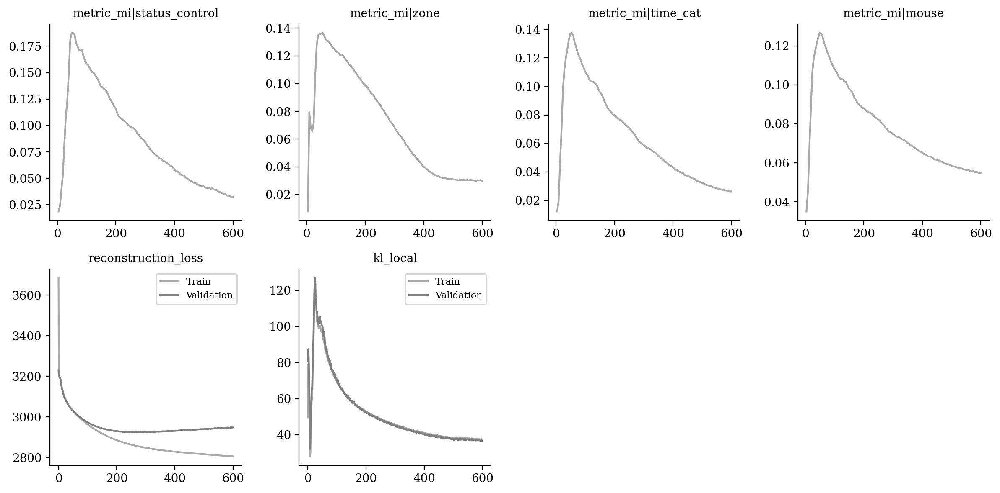

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

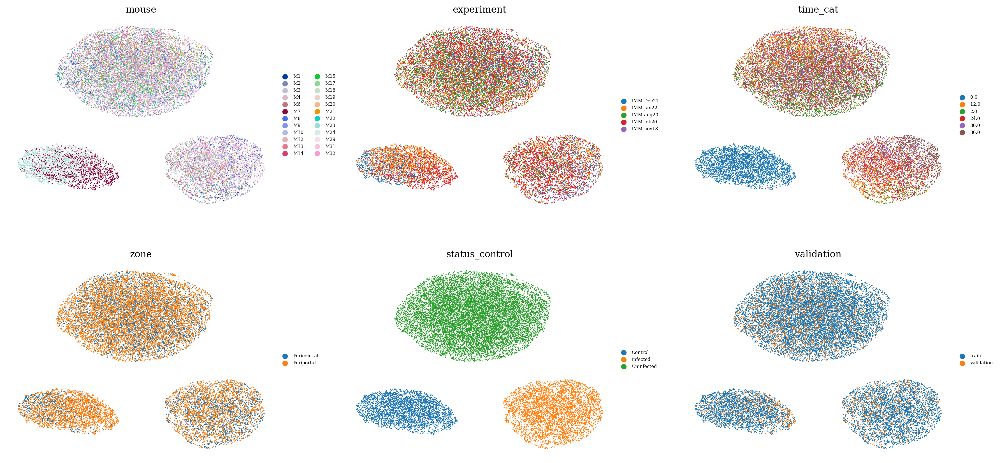

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

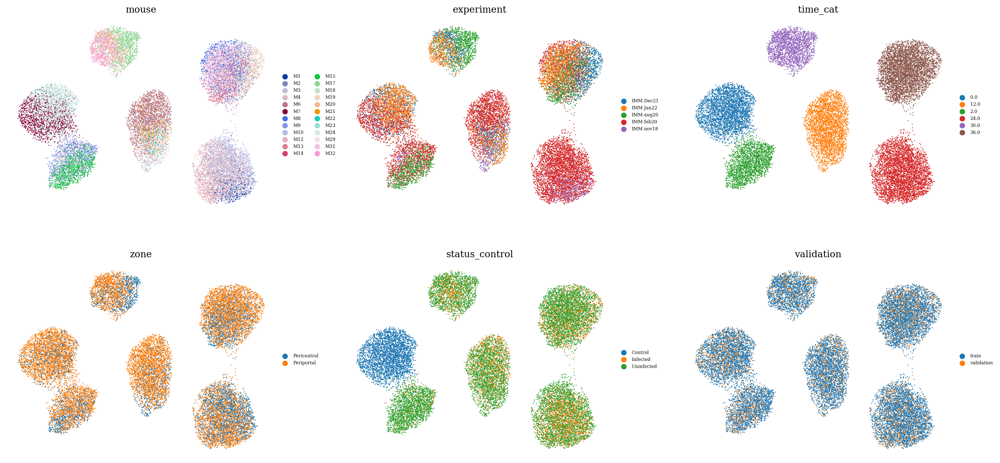

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

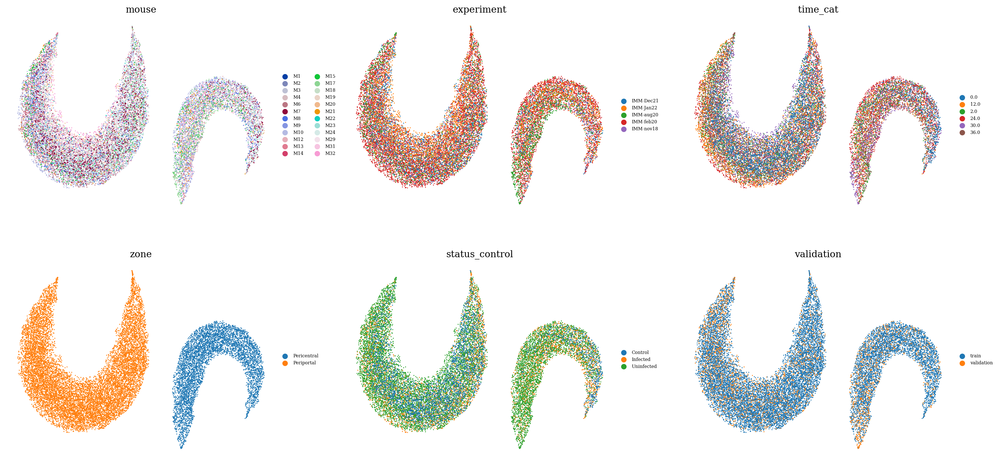

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

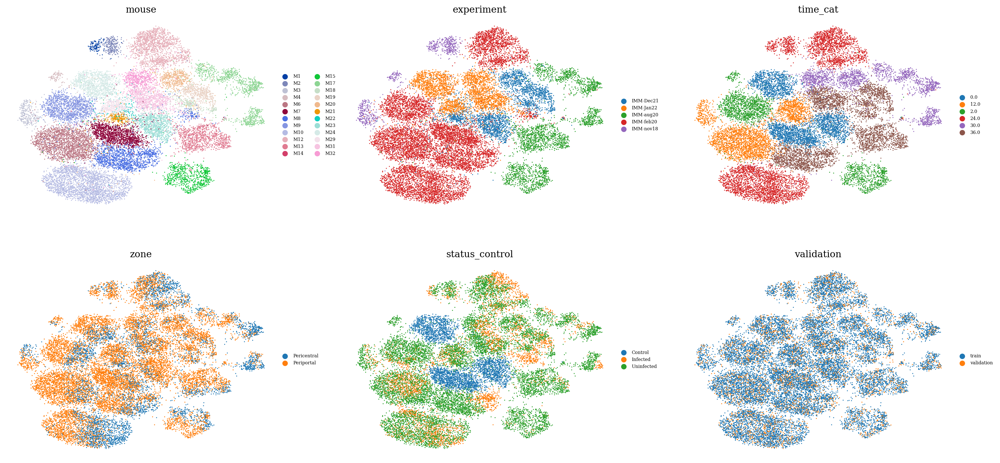

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

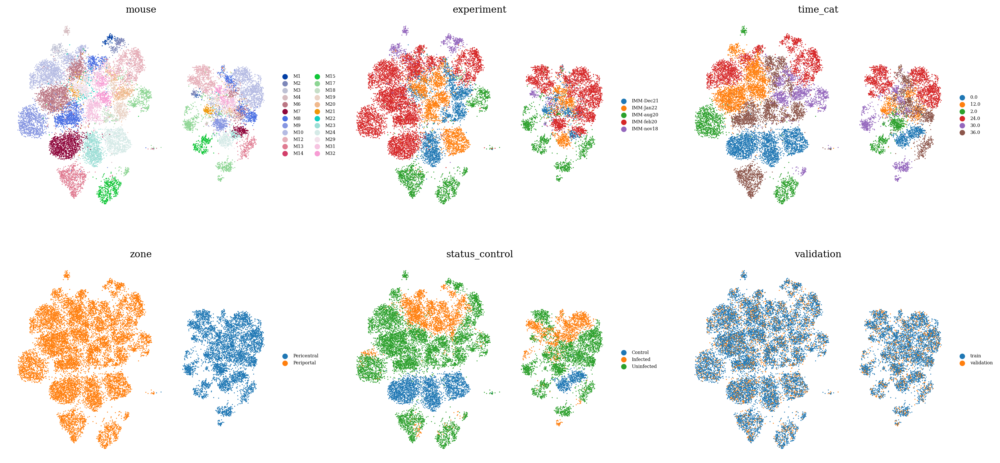

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

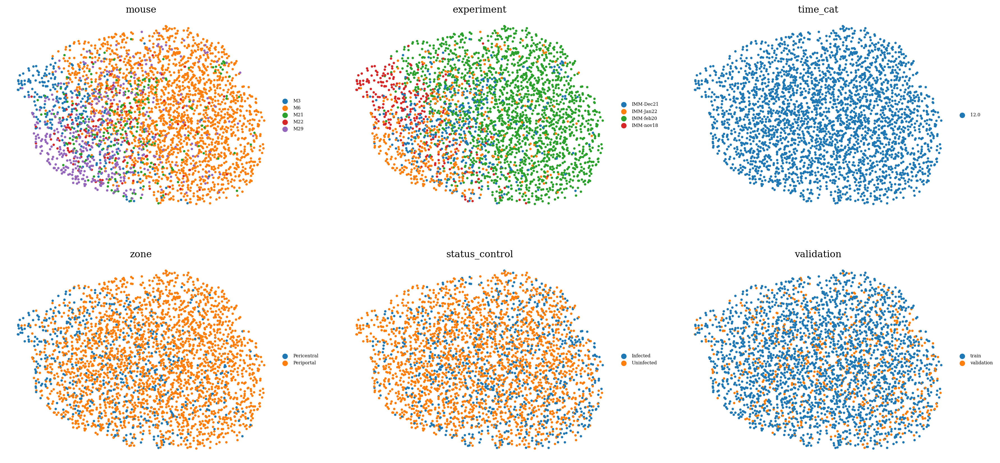

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )